# Distracted Driver Detection

**The purpose of this notebook is to develop a complex model that takes a picture as input and returns the driver's attention probability as output, I trained a variety of models in an attempt to determine which would provide the highest accuracy. The technique I used is separated into three categories:**
1. Regular Models
    1. Base line model
    2. CNN
2. Models with data augmentation
    1. Base line model
    2. CNN
3. Transfer learning (I tried 3 pre-trained models):
    1. MobileNet
    2. ResNet
    3. VGG 16

## Table of Contents

* [Loading Dataset](#chapter1)

* [EDA](#chapter2)
    * [Helper Functions](#section_2_1)
    * [Visualization](#section_2_2)
* [Modelisation](#chapter3)
    * [Without Data Augmentation](#section_3_1)
        * [Base Line Model](#section_3_1_1)
        * [CNN](#section_3_1_2)
    * [Data Augmentation](#section_3_2)
        * [Base Line Model](#section_3_2_1)
        * [CNN](#section_3_2_2)
    * [Transfer Learning](#section_3_3)
        * [Mobile net](#section_3_3_1)
        * [ResNet](#section_3_3_2)
        * [ResNet Tuning](#section_3_3_3)
        * [VGG16](#section_3_3_4)
* [Result & Findings](#chapter4)
* [Reference](#chapter5)

## 1. Loading Dataset <a class="anchor" id="chapter1"></a>

In [63]:

#Path
import os
import shutil
from zipfile import ZipFile

#Time
import timeit

#Data Manipulation
import pandas as pd
import numpy as np

#Data Visulization
import matplotlib.pyplot as plt
import matplotlib.style as style
import seaborn as sns

#Image processing
from mpl_toolkits.axes_grid1 import ImageGrid
import matplotlib.image as mpimg
from PIL import Image
import cv2

#Evaluation and split
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
import sklearn.metrics as metrics
from sklearn.metrics import confusion_matrix

#Build Model
import tensorflow as tf
import tensorflow_hub as hub

import tensorflow.keras as keras
from keras import layers
from tensorflow.keras.utils import plot_model
from tensorflow.keras import callbacks
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from keras.applications.vgg16 import VGG16
from tensorflow.keras.utils import to_categorical,model_to_dot
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential , Model
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout

In [2]:
path = r"D:\Uni\EPITA\S4\Computer Vision\Attenton"

In [3]:
df = pd.read_csv(path+'\driver_imgs_list.csv')
df.head(5)

,subject,classname,img
0,p002,c0,img_44733.jpg
1,p002,c0,img_72999.jpg
2,p002,c0,img_25094.jpg
3,p002,c0,img_69092.jpg
4,p002,c0,img_92629.jpg


In [2]:
#Unzipping the file
data =  path + "\imgs.zip"

with ZipFile(data,'r') as f:
    f.extractall()
    print("Done")

Done


## EDA <a class="anchor" id="chapter2"></a>

In [4]:
drivers = df.groupby('subject')
mean_imgs = round(df.groupby('subject').count()['classname'].mean())
print(f"This dataset contains {len(drivers)} different Drivers,\n Every driver have an average images of {mean_imgs} images")

This dataset contains 26 different Drivers,
 Every driver have an average images of 862 images


### Building Helper Functions <a class="anchor" id="section_2_1"></a>

In [5]:
def loss_plot(history):
    """
    Input: Model history
    Outplot: Graph of Model's loss
    Goal: Plot the differance between loss and validation loss over epochs 
    """
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'validation'], loc='upper left')
    plt.show()
    
def acc_plot(history):
    """
    Same as Above but for the differance between Accuracy and Validation accuracy
    """
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    plt.show()

In [6]:
def plot_res(model,test_set):
    """
    Input: the trained model with the test set
    Outplot: 20 pictures of the results with a true and predicted values as titles
    Goal: Visualize the model performance by testing it on 20 pictures
    """
    plt.figure(figsize=(20, 20))
    for i in range(0, 25):
        plt.subplot(5, 5, i+1)
        for X_batch, Y_batch in test_set:
            print(Y_batch)
            image = X_batch[0]
            plt.imshow(image)
            x=np.array(image).reshape(1,224,224,3)
            pred=model.predict(x)
            true_label=activity_map.get("c"+str(int(np.argmax(Y_batch[0]))))
            pred_label=activity_map.get("c"+str(int(np.argmax(pred))))
            plt.yticks([])
            plt.xticks([])
            plt.title(f"True: {true_label}\n pred: {pred_label}")
            break
    plt.tight_layout()
    plt.show()
    
def plot_res_res(model,test_set):
    """
    Same as the Above function but for ResNet model for better Visualizing
    """
    plt.figure(figsize=(20, 20))
    for i in range(0, 25):
        plt.subplot(5, 5, i+1)
        for X_batch, Y_batch in test_set:
            print(Y_batch)
            image = X_batch[0]
            plt.imshow(image.astype(np.uint8))
            x=np.array(image).reshape(1,224,224,3)
            pred=model.predict(x)
            true_label=activity_map.get("c"+str(int(np.argmax(Y_batch[0]))))
            pred_label=activity_map.get("c"+str(int(np.argmax(pred))))
            plt.yticks([])
            plt.xticks([])
            plt.title(f"True: {true_label}\n pred: {pred_label}")
            break
    plt.tight_layout()
    plt.show()

In [7]:
def matrix_and_report(model,test_set):
    """
    Input: Model and Test set
    Outplot: Classification report and Confusion_matrix
    Goal: Evaluate the model by checking the Report and Confusion matrix 
    """
    test_steps_per_epoch = numpy.math.ceil(test_set.samples / test_set.batch_size)
    predictions = model.predict(test_set)
    predicted_classes = np.argmax(predictions, axis=1)
    true_classes = test_set.classes
    class_labels = list(test_set.class_indices.keys()) 
    
    report = metrics.classification_report(true_classes, predicted_classes, target_names=class_labels)
    print(report)
    
    
    labels = [i for i in activity_map.keys()]
    cm = metrics.confusion_matrix(true_classes,predicted_classes)
    cm_df = pd.DataFrame(cm,columns=labels,
                     index=labels)

    plt.figure(figsize=(15,10))
    sns.heatmap(cm_df, annot=True,cmap='YlOrBr', fmt='g')
    plt.title('Confusion Matrix')
    plt.ylabel("Actual Values")
    plt.xlabel('Predicted Values')
    plt.show()


In [8]:
def time_acc(empty_dict,models,test_gen):
    """
    Input: Empty Dictionary, Model and Test set 
    Outplot: Model Evaluation
    Goal: Evaluate each model and appened the results into dataframe to compare the performance
    """
    for keys,values in models.items():
        start = timeit.default_timer()
        print(keys)
        empty_dict["Model"].append(keys)
        test_loss,test_acc = values.evaluate(test_gen)
        empty_dict["Loss"].append(test_loss)
        empty_dict["Accurecy"].append(test_acc)
        stop = timeit.default_timer()
        end = stop - start
        empty_dict["Evaluate Time"].append(end)    
        print('Time: ', stop - start)  

In [31]:
def per_barplot(column=None,title=None,xlabel=None,ylabel=None,color=None,palette=None,ax=None):
  """
  Input: Column name,Title,Labels,Colors,Palette and Axes
Outplot: Barplot with a percentage above each column
Goal: Comparison between different column values
  """
  counts = column.value_counts().reset_index()
  percentage = []
  for x in range(counts.shape[0]):
      pct = (counts.iloc[:,1][x] / counts.iloc[:,1].sum()) * 100
      percentage.append(round(pct,2))
  counts['Percentage'] = percentage

  counts = counts.sort_values('index',ascending=True)  

  style.use('seaborn-poster')
  style.use('ggplot')

  g = sns.barplot(x=counts.iloc[:,0],  y=counts.iloc[:,1],ax=ax,color = color,palette=palette) 

  i = 0
  for p in g.patches:
      width = p.get_width()
      height = p.get_height()
      x, y = p.get_xy()
      plt.text(x+width/2,
              y+height*1.01,
              str(counts['Percentage'].iloc[i])+'%',
              ha='center',
              weight='bold')
      i+=1

  plt.title(title, fontweight="bold",fontsize=20)
  plt.xticks(fontsize=15)
  plt.yticks(fontsize=15)
  plt.xlabel(xlabel, fontweight="bold", fontsize=15)
  plt.ylabel(ylabel, fontweight="bold", fontsize=15)

  plt.grid(axis="y",color = 'grey', linestyle = '--', linewidth = 1.5)


  plt.show()

In [32]:
def h_per_barplot(column=None,title=None,xlabel=None,ylabel=None,color=None,palette=None,ax=None):
  """
  Same as the Last function but for horizontal bar plot
  """
  counts = column.value_counts().reset_index()

  percentage = []
  for x in range(counts.shape[0]):
      pct = (counts.iloc[:,1][x] / counts.iloc[:,1].sum()) * 100
      percentage.append(round(pct,2))
  counts['Percentage'] = percentage
  
  counts = counts.sort_index(ascending=True)


  style.use('seaborn-poster')
  style.use('ggplot')

  g = sns.barplot(y=counts.iloc[:,0],  x=counts.iloc[:,1],ax=ax,orient = 'h',color=color,palette=palette) 

  i = 0
  for p in g.patches:
      width = p.get_width()
      g.text(width+1,
              p.get_y() + p.get_height() / 2,
              str(counts['Percentage'].iloc[i])+'%',
              ha='left',
             va = 'center',
              weight='bold')
      i+=1

  plt.title(title, fontweight="bold",fontsize=20)
  plt.xticks(fontsize=15)
  plt.yticks(fontsize=15)
  plt.xlabel(xlabel, fontweight="bold", fontsize=15)
  plt.ylabel(ylabel, fontweight="bold", fontsize=15)

  plt.grid(axis="x",color = 'grey', linestyle = '--', linewidth = 1.5)


  plt.show()

### Visualization <a class="anchor" id="section_2_2"></a>

Based on the Graph below we can see that we have more picture in the first Category which is **Safe Driving** with a total of 11.1% and the lowest category is **Hair and Makeup** woth 8.52%

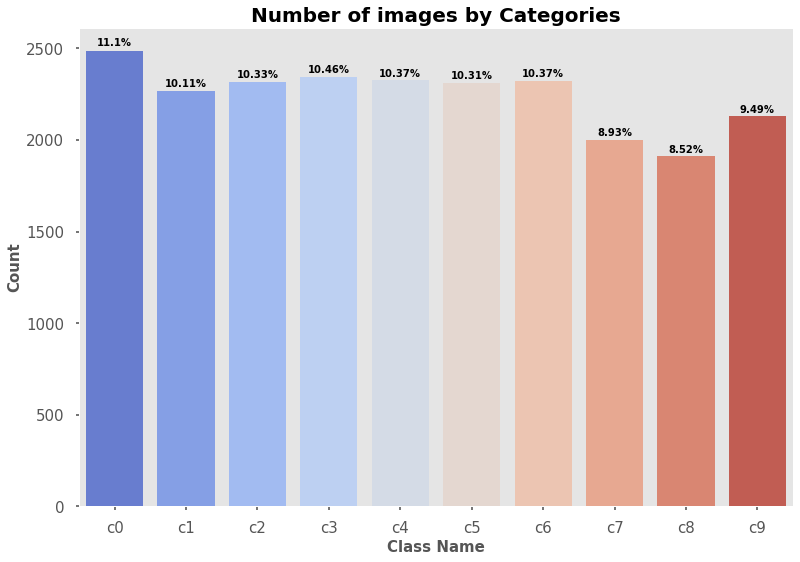

In [33]:
per_barplot(column = df['classname'],
            title="Number of images by Categories",
            xlabel="Class Name",ylabel="Count",
            palette='coolwarm')

**The below Graph represents the number of picture per driver**

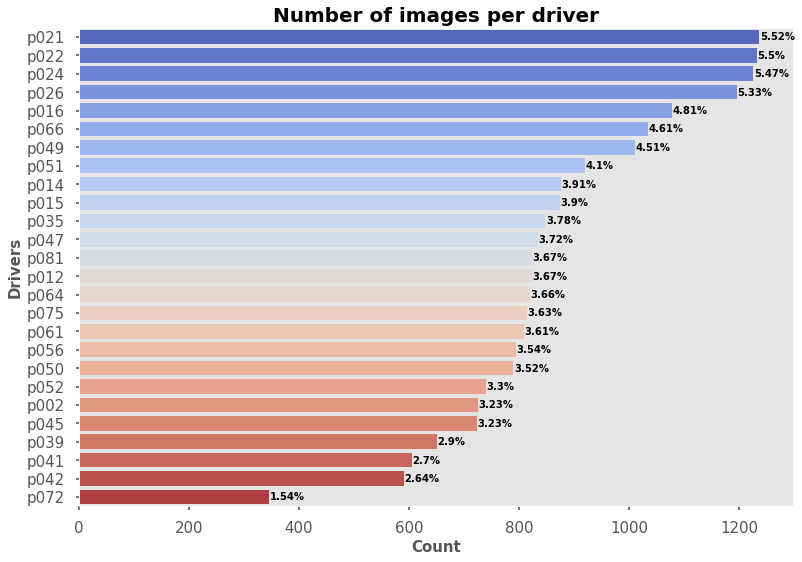

In [34]:
h_per_barplot(column = df['subject'],
              title="Number of images per driver",
              ylabel="Drivers",xlabel="Count",
              palette='coolwarm')

**For visualization purposes, I Crated a dictionary containing the class name each class.**

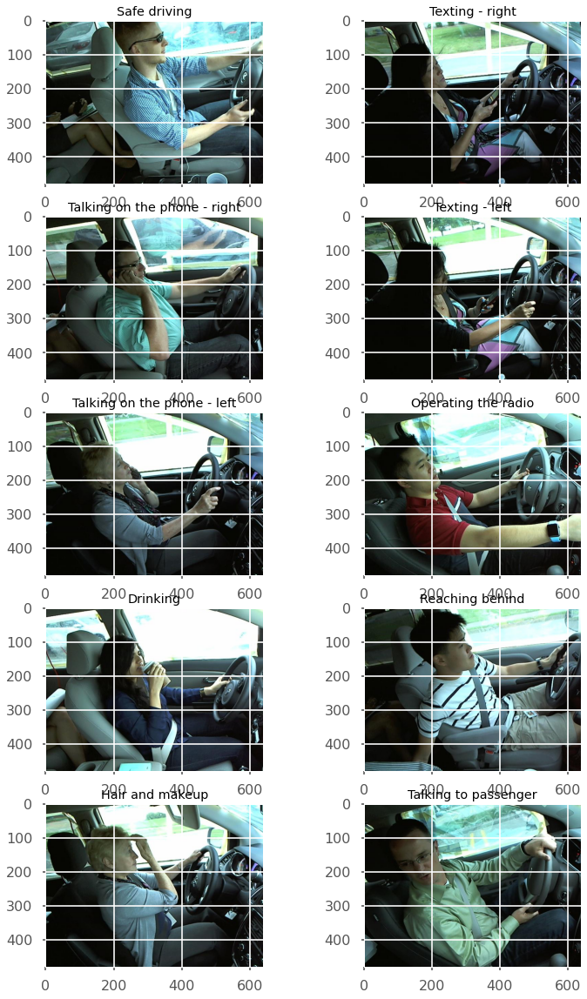

In [35]:
activity_map = {'c0': 'Safe driving', 
                'c1': 'Texting - right', 
                'c2': 'Talking on the phone - right', 
                'c3': 'Texting - left', 
                'c4': 'Talking on the phone - left', 
                'c5': 'Operating the radio', 
                'c6': 'Drinking', 
                'c7': 'Reaching behind', 
                'c8': 'Hair and makeup', 
                'c9': 'Talking to passenger'}


plt.figure(figsize = (12, 20))
image_count = 1
BASE_URL = path + '\\train\\'
for directory in os.listdir(BASE_URL):
    if directory[0] != '.':
        for i, file in enumerate(os.listdir(BASE_URL + directory)):
            if i == 1:
                break
            else:
                fig = plt.subplot(5, 2, image_count)
                image_count += 1
                image = mpimg.imread(BASE_URL + directory + '/' + file)
                plt.imshow(image)
                plt.title(activity_map[directory])

In [36]:
imgs=[]
names=[]
for label in list(activity_map.keys()):
    imgs_name=shuffle(df[df["classname"] == label])["img"][:5]
    imgs.extend(imgs_name)
    names.extend(((label+" ")*5).split())

print(imgs)
print(names)

['img_28115.jpg', 'img_60373.jpg', 'img_44419.jpg', 'img_81517.jpg', 'img_97281.jpg', 'img_40079.jpg', 'img_61447.jpg', 'img_59890.jpg', 'img_30434.jpg', 'img_47896.jpg', 'img_64426.jpg', 'img_34386.jpg', 'img_37711.jpg', 'img_58270.jpg', 'img_40360.jpg', 'img_23859.jpg', 'img_91604.jpg', 'img_25460.jpg', 'img_43787.jpg', 'img_18841.jpg', 'img_42125.jpg', 'img_48670.jpg', 'img_26479.jpg', 'img_72913.jpg', 'img_49642.jpg', 'img_54602.jpg', 'img_12896.jpg', 'img_37549.jpg', 'img_54068.jpg', 'img_66246.jpg', 'img_38382.jpg', 'img_27906.jpg', 'img_95092.jpg', 'img_98642.jpg', 'img_53153.jpg', 'img_70595.jpg', 'img_60610.jpg', 'img_63641.jpg', 'img_55992.jpg', 'img_39295.jpg', 'img_25061.jpg', 'img_94489.jpg', 'img_94317.jpg', 'img_51493.jpg', 'img_67177.jpg', 'img_37002.jpg', 'img_93519.jpg', 'img_9676.jpg', 'img_70361.jpg', 'img_62462.jpg']
['c0', 'c0', 'c0', 'c0', 'c0', 'c1', 'c1', 'c1', 'c1', 'c1', 'c2', 'c2', 'c2', 'c2', 'c2', 'c3', 'c3', 'c3', 'c3', 'c3', 'c4', 'c4', 'c4', 'c4', 'c4',

**Now it's the time to see images from each class**

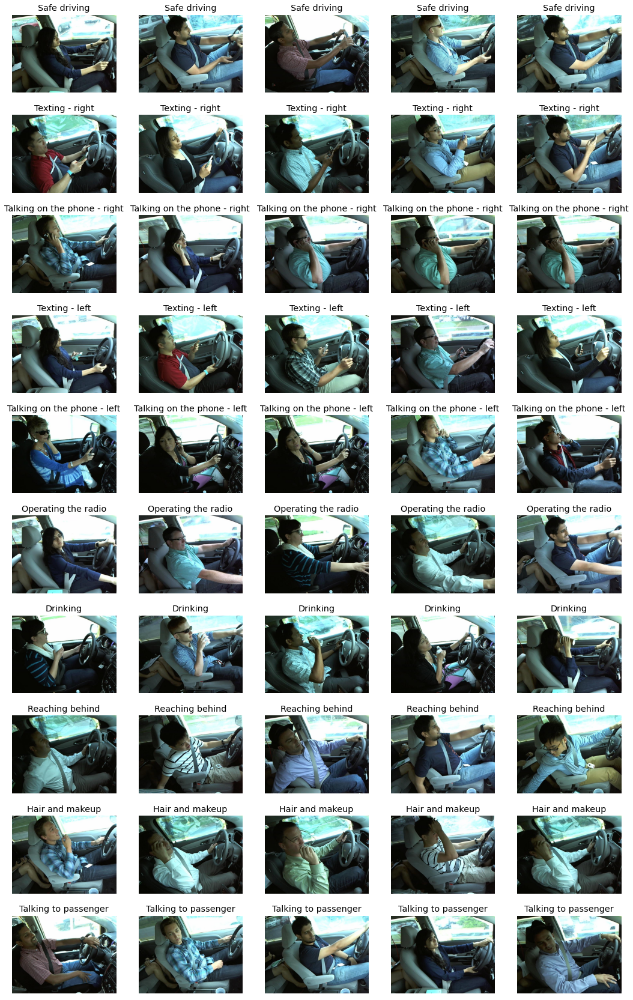

In [37]:
fig = plt.figure(figsize=(30, 30))
grid = ImageGrid(fig, 111,  # similar to subplot(111)
                 nrows_ncols=(10, 5),  # creates 2x2 grid of axes
                 axes_pad=0.5, label_mode='all' # pad between axes in inch.
)
i=0
file_path=path+"/train/"
for axes in grid:
    img=cv2.imread(file_path+names[i]+"/"+imgs[i])
    rgb_img=cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    axes.imshow(rgb_img)
    axes.xaxis.set_visible(False)
    axes.yaxis.set_visible(False)
    axes.set_title(activity_map.get(names[i]))
    i+=1

plt.show()

## 3. Modelisation <a class="anchor" id="chapter3"></a>

After visualizing and examining the files, the first step in building a model is to split and shuffle the dataset and identify the **Dependent and Independent variables**.

In [38]:
x_data=df["img"]
y_data=df["classname"]

In [39]:
x_train,x_test,y_train,y_test=train_test_split(x_data,y_data,test_size = 0.4,
                                               random_state = 42,shuffle=True)

Splitting the test set into test and validation set

In [40]:
x_valid,xtest,y_valid,ytest=train_test_split(x_test,y_test,test_size = 0.4,
                                             random_state = 42,shuffle=True)

In [41]:
x_train = pd.DataFrame(x_train.reset_index(drop=True))
x_valid = pd.DataFrame(x_valid.reset_index(drop=True))
xtest = pd.DataFrame(xtest.reset_index(drop=True))

y_train = pd.DataFrame(y_train.reset_index(drop=True))
y_valid = pd.DataFrame(y_valid.reset_index(drop=True))
ytest = pd.DataFrame( ytest.reset_index(drop=True))

In [42]:
x_train

,img
0,img_47981.jpg
1,img_79836.jpg
2,img_55100.jpg
3,img_72476.jpg
4,img_101087.jpg
...,...
13449,img_38722.jpg
13450,img_85062.jpg
13451,img_4853.jpg
13452,img_74587.jpg


Creating three different directories (Train, Test, and Validation) and each folder contains 10 subfolder each one containing one class so we can pass it to **flow_from_directory** function later.

In [49]:
source_path=path+"\\train"
train_path=path+"\\img\\train"
valid_path=path+"\\img\\valid"
test_path=path+"\\img\\test"
os.makedirs(train_path)
os.makedirs(valid_path)
os.makedirs(test_path)

In [170]:
for i in range(len(x_train)):
    class_name=y_train['classname'][i]
    img=x_train['img'][i]
    if os.path.exists(train_path + class_name):
        shutil.copy(source_path  +"\\"+class_name+"\\"+img , train_path + class_name+"\\"+img)
    else:
        os.makedirs(train_path + class_name)

In [174]:
for i in range(len(x_valid)):
    class_name=y_valid['classname'][i]
    img=x_valid['img'][i]
    if os.path.exists(valid_path + class_name):
        shutil.copy(source_path +"\\"+ class_name+"\\"+img , valid_path + class_name+"\\"+img)
    else:
        os.makedirs(valid_path + class_name)

In [176]:
for i in range(len(xtest)):
    class_name=ytest['classname'][i]
    img=xtest['img'][i]
    if os.path.exists(test_path + class_name):
        shutil.copy(source_path +"\\"+ class_name+"\\"+img , test_path + class_name+"\\"+img)  
    else:
        os.makedirs(test_path + class_name)

In [43]:
normal_datagen = ImageDataGenerator(rescale=1 / 255.0)

Transfer on image into Array

In [44]:
example=path+"\\img\\train\\c0\\img_973.jpg"
image=cv2.imread(example)
image_resize=cv2.resize(image,(224,224))
img=np.array(image_resize).reshape(1,224,224,3)
img

array([[[[ 20,  30,  24],
         [ 22,  32,  26],
         [ 24,  34,  28],
         ...,
         [246, 240, 155],
         [228, 227, 147],
         [251, 249, 189]],

        [[ 23,  33,  27],
         [ 23,  33,  27],
         [ 22,  32,  26],
         ...,
         [254, 250, 176],
         [246, 243, 182],
         [254, 253, 217]],

        [[ 25,  32,  27],
         [ 26,  33,  28],
         [ 26,  33,  28],
         ...,
         [254, 254, 194],
         [255, 255, 212],
         [255, 253, 234]],

        ...,

        [[ 29,  40,  24],
         [ 30,  40,  24],
         [ 37,  48,  32],
         ...,
         [  6,   9,  14],
         [ 12,  15,  20],
         [ 10,  13,  19]],

        [[ 21,  30,  17],
         [ 37,  45,  32],
         [ 38,  45,  32],
         ...,
         [  6,   8,  17],
         [ 16,  19,  27],
         [  6,   8,  16]],

        [[ 32,  36,  24],
         [ 45,  49,  37],
         [ 46,  50,  38],
         ...,
         [  5,   7,  15],
        

Change this array into Categorical values meaning that this picture is belonging to the first class which is Safe driving

In [45]:
y_1=[0]
y_1=to_categorical(y_1,10)
y_1=np.array(y_1).reshape(1,-1)
print(y_1)

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


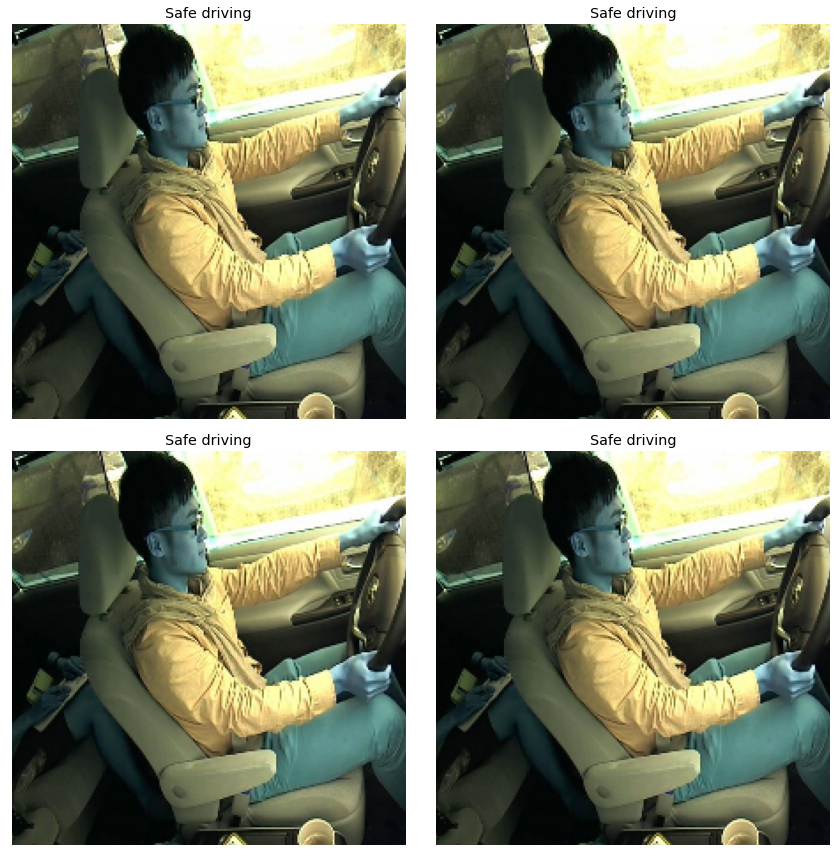

In [46]:
train_one_image_generator= normal_datagen.flow(
    img,
    y_1,
    batch_size=32
)



plt.figure(figsize=(12, 12))
for i in range(0, 4):
    plt.subplot(2, 2, i+1)
    for X_batch, Y_batch in train_one_image_generator:
        image = X_batch[0]
        plt.imshow(image)
        plt.yticks([])
        plt.xticks([])
        plt.title(activity_map.get("c"+str(int(np.argmax(Y_batch[0])))))
        break
plt.tight_layout()
plt.show()

I built three different data generators :
1. Train
2. Validation
3. Test and other test with no shuffle into order to build the confusion matrix

In [50]:
batchs = 32
train_generator_normal=normal_datagen.flow_from_directory(
    directory=train_path,
    target_size=(224, 224),
    batch_size=batchs,
    class_mode="categorical",
    shuffle=True
)

valid_generator_normal=normal_datagen.flow_from_directory(
    directory=valid_path,
    target_size=(224, 224),
    batch_size=batchs,
    class_mode="categorical",
    shuffle=True
)


test_generator_normal=normal_datagen.flow_from_directory(
    directory=test_path,
    target_size=(224, 224),
    batch_size=1,
    class_mode="categorical",
    shuffle=True
)

test_generator_normal_cm=normal_datagen.flow_from_directory(
    directory=test_path,
    target_size=(224, 224),
    batch_size=1,
    class_mode="categorical",
    shuffle=False
)

Found 13448 images belonging to 10 classes.
Found 5377 images belonging to 10 classes.
Found 3578 images belonging to 10 classes.
Found 3578 images belonging to 10 classes.


In [51]:
callbacks_ = [callbacks.EarlyStopping(monitor='val_loss', mode='min',patience=3)]

## 3.1 Without Data Augmentation <a class="anchor" id="section_3_1"></a>

From this point till the end of the notebook, the next procedures are identical for each model:
1. Design the model
2. Compile and fit the model
    - I Choose Adam Optimizer because it's faster than SGD
    - For the Loss it was Categorical Crossentropy because we have multi class problem
3. Evaluate the model
4. Examine the graphs for Accuracy and Loss.
5. Report on classification and Confution matrix

## 3.1.1 Baseline model <a class="anchor" id="section_3_1_1"></a>

Baseline Model with 5 Dense layers and RelU as the activation function; the final layer has 10 because there are 10 classes and softmax as the activation function.

In [58]:
dense_model=keras.models.Sequential()
dense_model.add(layers.Flatten(input_shape=(224,224,3)))
dense_model.add(layers.Dense(1024, activation='relu', name='Layer_1'))
dense_model.add(layers.Dense(512, activation='relu', name='Layer_2'))
dense_model.add(layers.Dense(512, activation='relu', name='Layer_3'))
dense_model.add(layers.Dense(256, activation='relu', name='Layer_4'))
dense_model.add(layers.Dense(128, activation='relu', name='Layer_5'))
dense_model.add(layers.Dense(10, activation='softmax',name='final_layer'))
dense_model.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 150528)            0         
                                                                 
 Layer_1 (Dense)             (None, 1024)              154141696 
                                                                 
 Layer_2 (Dense)             (None, 512)               524800    
                                                                 
 Layer_3 (Dense)             (None, 512)               262656    
                                                                 
 Layer_4 (Dense)             (None, 256)               131328    
                                                                 
 Layer_5 (Dense)             (None, 128)               32896     
                                                                 
 final_layer (Dense)         (None, 10)                1

In [210]:
dense_model.compile(optimizer=keras.optimizers.Adam(),
                loss='categorical_crossentropy',
                metrics=['accuracy'])

In [211]:
history_1=dense_model.fit(train_generator_normal,
                          validation_data=valid_generator_normal,
                          epochs=10,
                          verbose=1,
                          callbacks=callbacks_)

Epoch 1/10
421/421 [==============================] - 325s 771ms/step - loss: 3.6155 - accuracy: 0.4064 - val_loss: 0.8168 - val_accuracy: 0.7127
Epoch 2/10
421/421 [==============================] - 246s 584ms/step - loss: 0.6064 - accuracy: 0.7903 - val_loss: 0.3097 - val_accuracy: 0.9012
Epoch 3/10
421/421 [==============================] - 245s 582ms/step - loss: 0.3574 - accuracy: 0.8801 - val_loss: 0.4183 - val_accuracy: 0.8654
Epoch 4/10
421/421 [==============================] - 245s 581ms/step - loss: 0.2685 - accuracy: 0.9146 - val_loss: 0.3929 - val_accuracy: 0.8787
Epoch 5/10
421/421 [==============================] - 246s 584ms/step - loss: 0.1831 - accuracy: 0.9426 - val_loss: 0.0978 - val_accuracy: 0.9740
Epoch 6/10
421/421 [==============================] - 249s 590ms/step - loss: 0.1646 - accuracy: 0.9485 - val_loss: 0.2342 - val_accuracy: 0.9224
Epoch 7/10
421/421 [==============================] - 256s 608ms/step - loss: 0.1596 - accuracy: 0.9474 - val_loss: 0.1117 -

In [227]:
test_loss, test_acc = dense_model.evaluate(test_generator_normal)

3578/3578 [==============================] - 128s 36ms/step - loss: 0.2854 - accuracy: 0.9053


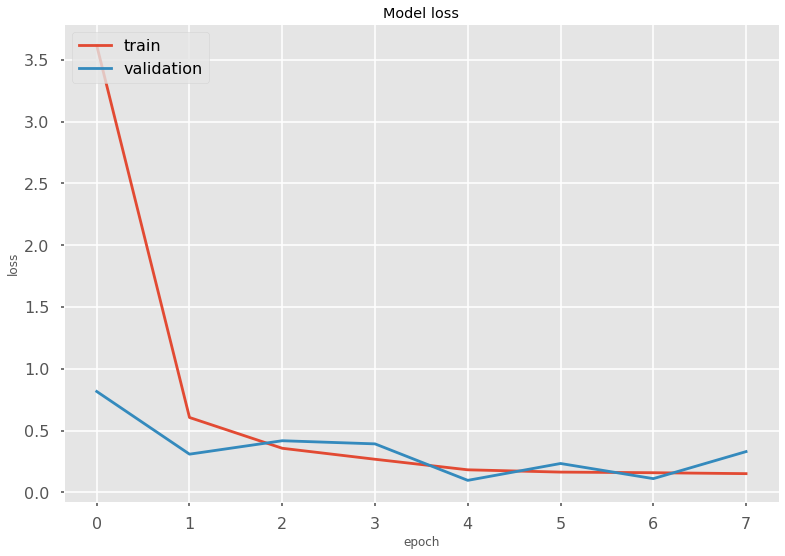

In [466]:
loss_plot(history_1)

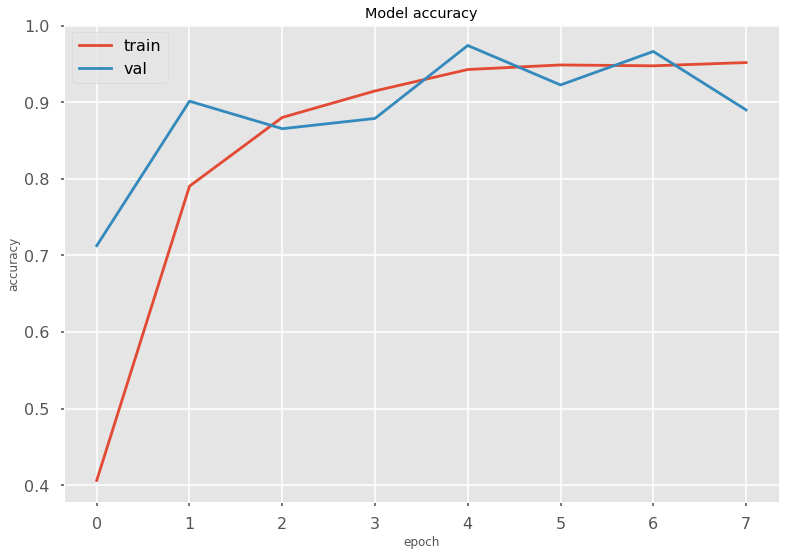

In [467]:
acc_plot(history_1)

[[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 55ms/step
[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 44ms/step
[[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 47ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
1/1 [==============================] - 0s 48ms/step
[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 49ms/step
[[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 47ms/step
[[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 48ms/step
[[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
1/1 [==============================] - 0s 47ms/step
[[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 47ms/step
[[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]]
1/1 [==============================] - 0s 49ms/step
[[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
1/1 [==============================] - 0s 48ms/step
[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [===============

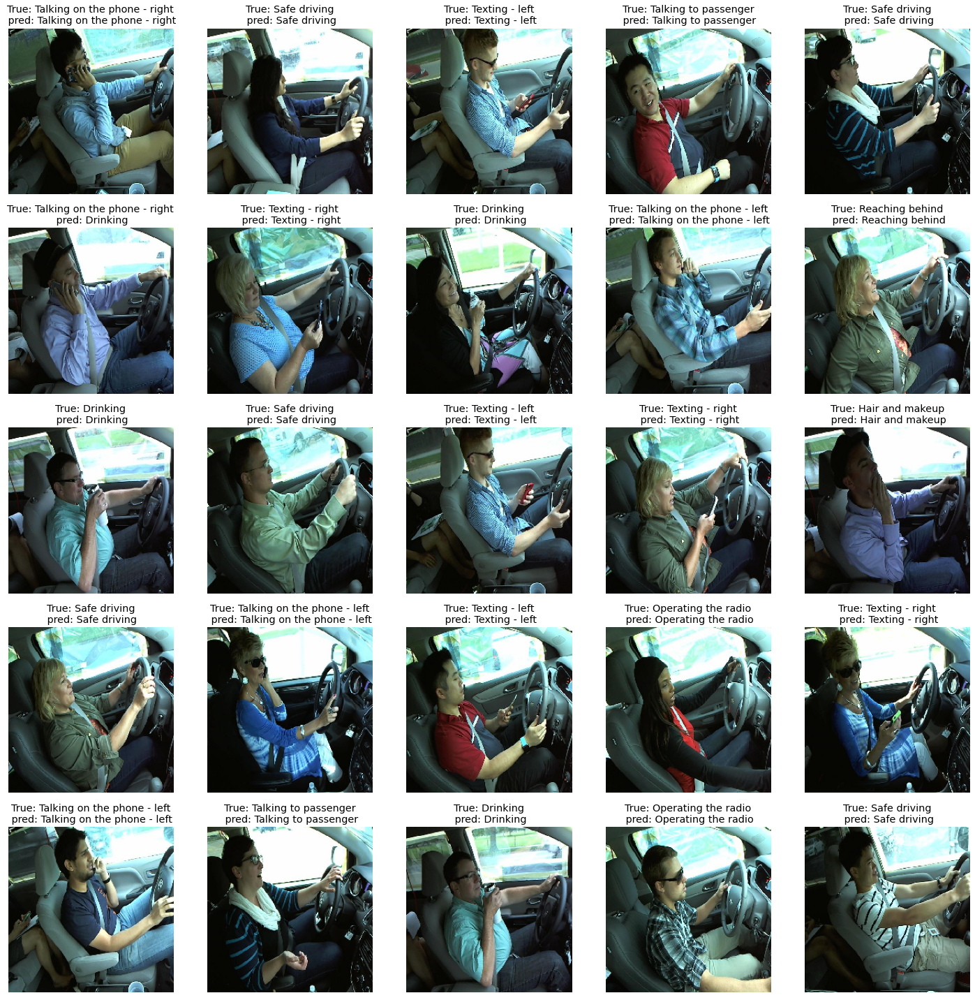

In [715]:
plot_res(dense_model,test_generator_normal)

3578/3578 [==============================] - 155s 43ms/step
              precision    recall  f1-score   support

          c0       0.97      0.76      0.85       392
          c1       1.00      0.91      0.95       375
          c2       1.00      0.68      0.81       355
          c3       0.93      0.91      0.92       366
          c4       0.80      0.99      0.89       360
          c5       0.98      0.98      0.98       373
          c6       0.77      0.99      0.87       379
          c7       0.99      0.96      0.98       313
          c8       0.82      0.96      0.88       332
          c9       0.93      0.94      0.93       333

    accuracy                           0.91      3578
   macro avg       0.92      0.91      0.91      3578
weighted avg       0.92      0.91      0.90      3578



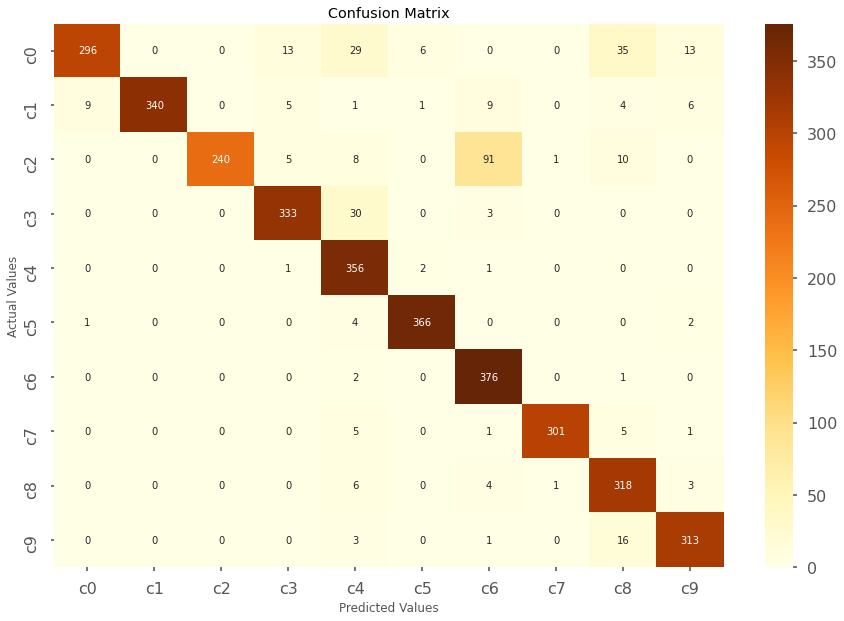

In [820]:
matrix_and_report(dense_model,test_generator_normal_cm)

## 3.1.2 CNN  <a class="anchor" id="section_3_1_2"></a>

The CNN models receive a picture and send it to four Layers. Each layer consists of a Conv and a pooling layer, which are connected and sent to the output layer.

In [221]:
cnn_model = models.Sequential()

cnn_model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224,3)))
cnn_model.add(layers.MaxPooling2D((2, 2)))

cnn_model.add(layers.Conv2D(64, (3, 3), activation='relu'))
cnn_model.add(layers.MaxPooling2D((2, 2)))

cnn_model.add(layers.Conv2D(128, (3, 3), activation='relu'))
cnn_model.add(layers.MaxPooling2D((2, 2)))

cnn_model.add(layers.Conv2D(128, (3, 3), activation='relu'))
cnn_model.add(layers.MaxPooling2D((2, 2)))

cnn_model.add(layers.Flatten())
cnn_model.add(layers.Dense(128, activation='relu'))
cnn_model.add(layers.Dense(10, activation='softmax'))
cnn_model.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_14 (Conv2D)          (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d_11 (MaxPoolin  (None, 111, 111, 32)     0         
 g2D)                                                            
                                                                 
 conv2d_15 (Conv2D)          (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_12 (MaxPoolin  (None, 54, 54, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_16 (Conv2D)          (None, 52, 52, 128)       73856     
                                                                 
 max_pooling2d_13 (MaxPoolin  (None, 26, 26, 128)     

In [223]:
cnn_model.compile(optimizer=keras.optimizers.Adam(),
                loss='categorical_crossentropy',
                metrics=['accuracy'])

In [224]:
history_2=cnn_model.fit(train_generator_normal,
                          validation_data=valid_generator_normal,
                          epochs=10, 
                          verbose=1,
                          callbacks=callbacks_)

Epoch 1/10
421/421 [==============================] - 440s 1s/step - loss: 0.7945 - accuracy: 0.7267 - val_loss: 0.1858 - val_accuracy: 0.9515
Epoch 2/10
421/421 [==============================] - 393s 934ms/step - loss: 0.0878 - accuracy: 0.9743 - val_loss: 0.0939 - val_accuracy: 0.9764
Epoch 3/10
421/421 [==============================] - 415s 985ms/step - loss: 0.0378 - accuracy: 0.9883 - val_loss: 0.0980 - val_accuracy: 0.9775
Epoch 4/10
421/421 [==============================] - 395s 938ms/step - loss: 0.0306 - accuracy: 0.9909 - val_loss: 0.0735 - val_accuracy: 0.9833
Epoch 5/10
421/421 [==============================] - 396s 940ms/step - loss: 0.0239 - accuracy: 0.9933 - val_loss: 0.1348 - val_accuracy: 0.9704
Epoch 6/10
421/421 [==============================] - 393s 933ms/step - loss: 0.0192 - accuracy: 0.9941 - val_loss: 0.0533 - val_accuracy: 0.9911
Epoch 7/10
421/421 [==============================] - 400s 951ms/step - loss: 0.0155 - accuracy: 0.9951 - val_loss: 0.0708 - va

In [226]:
test_loss, test_acc = cnn_model.evaluate(test_generator_normal)

3578/3578 [==============================] - 45s 12ms/step - loss: 0.0783 - accuracy: 0.9843


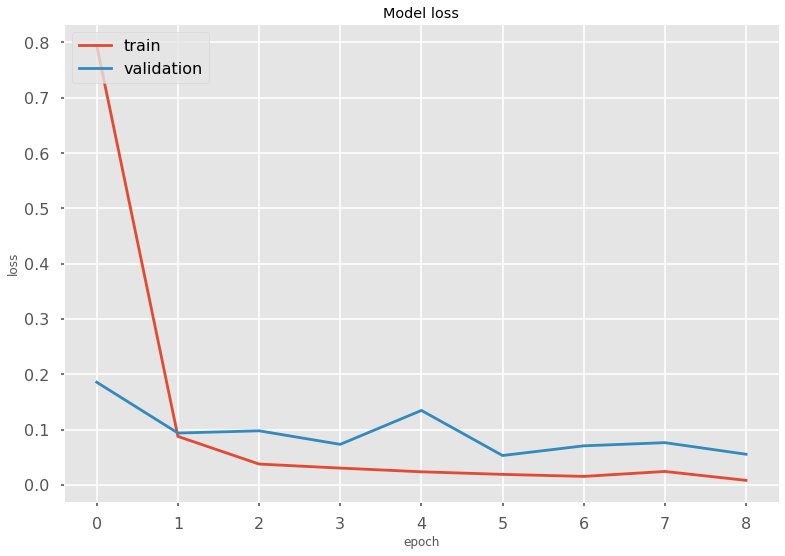

In [396]:
loss_plot(history_2)

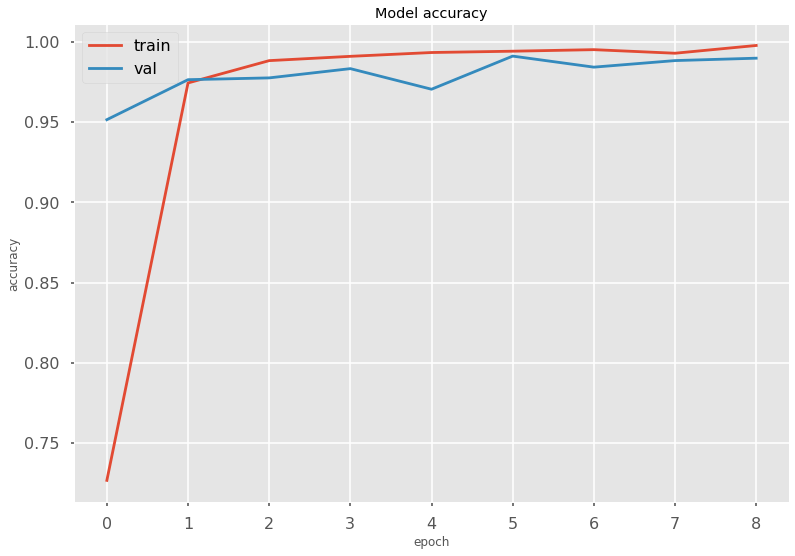

In [397]:
acc_plot(history_2)

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 24ms/step
[[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 21ms/step
[[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 21ms/step
[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 25ms/step
[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 25ms/step
[[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 26ms/step
[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 22ms/step
[[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 23ms/step
[[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 29ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
1/1 [==============================] - 0s 24ms/step
[[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 20ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]]
1/1 [===============

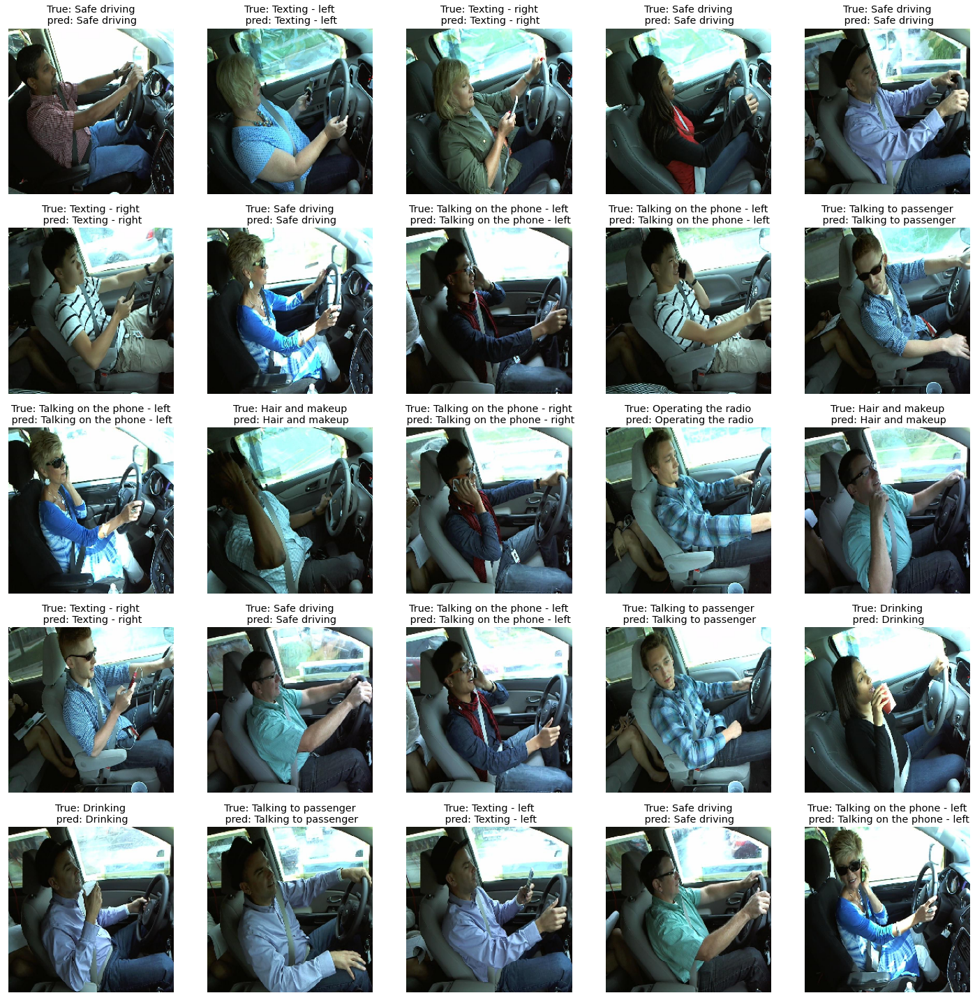

In [716]:
plot_res(cnn_model,test_generator_normal)

3578/3578 [==============================] - 41s 12ms/step
              precision    recall  f1-score   support

          c0       0.99      0.97      0.98       392
          c1       0.97      1.00      0.99       375
          c2       0.99      0.99      0.99       355
          c3       0.99      0.98      0.98       366
          c4       0.99      0.99      0.99       360
          c5       1.00      0.99      0.99       373
          c6       0.99      0.99      0.99       379
          c7       1.00      0.99      0.99       313
          c8       0.96      0.98      0.97       332
          c9       0.95      0.96      0.96       333

    accuracy                           0.98      3578
   macro avg       0.98      0.98      0.98      3578
weighted avg       0.98      0.98      0.98      3578



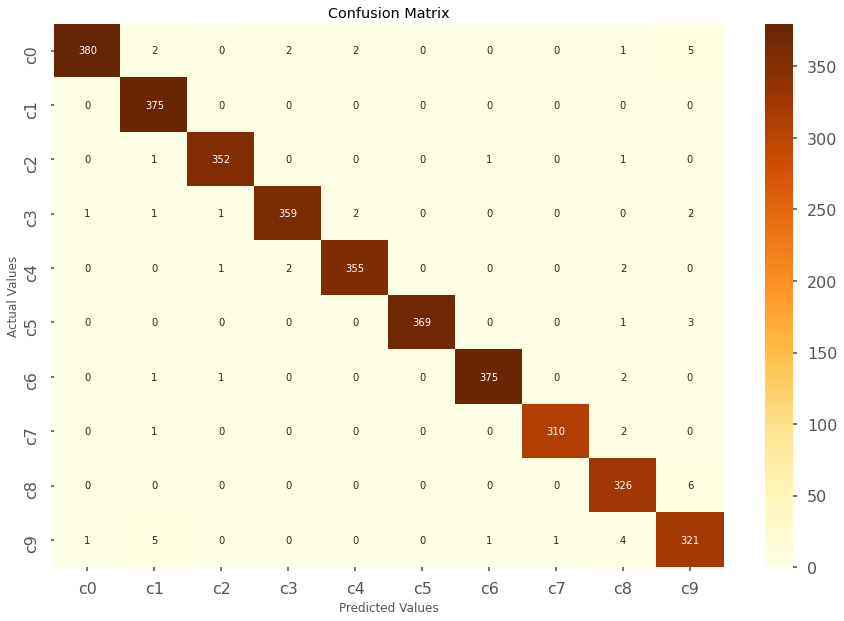

In [821]:
matrix_and_report(cnn_model,test_generator_normal_cm)

## 3.2 Data Augmentation <a class="anchor" id="section_3_2"></a>

I attempted to boost accuracy by using Augmentation techniques.

In [718]:
#Generate Images with differant features
train_datagen_augmentation = ImageDataGenerator(
    rescale=1./255,
    shear_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
    vertical_flip=False,
    width_shift_range=0.1,
    height_shift_range=0.1,
    rotation_range=20,
    fill_mode='nearest',
    featurewise_center = True,
    featurewise_std_normalization = True
)

test_datagen_augmentation = ImageDataGenerator(rescale=1./255)

C:\Users\Mostafa\anaconda3\lib\site-packages\keras\preprocessing\image.py:1863: UserWarning: This ImageDataGenerator specifies `featurewise_center`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn(
C:\Users\Mostafa\anaconda3\lib\site-packages\keras\preprocessing\image.py:1873: UserWarning: This ImageDataGenerator specifies `featurewise_std_normalization`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn(


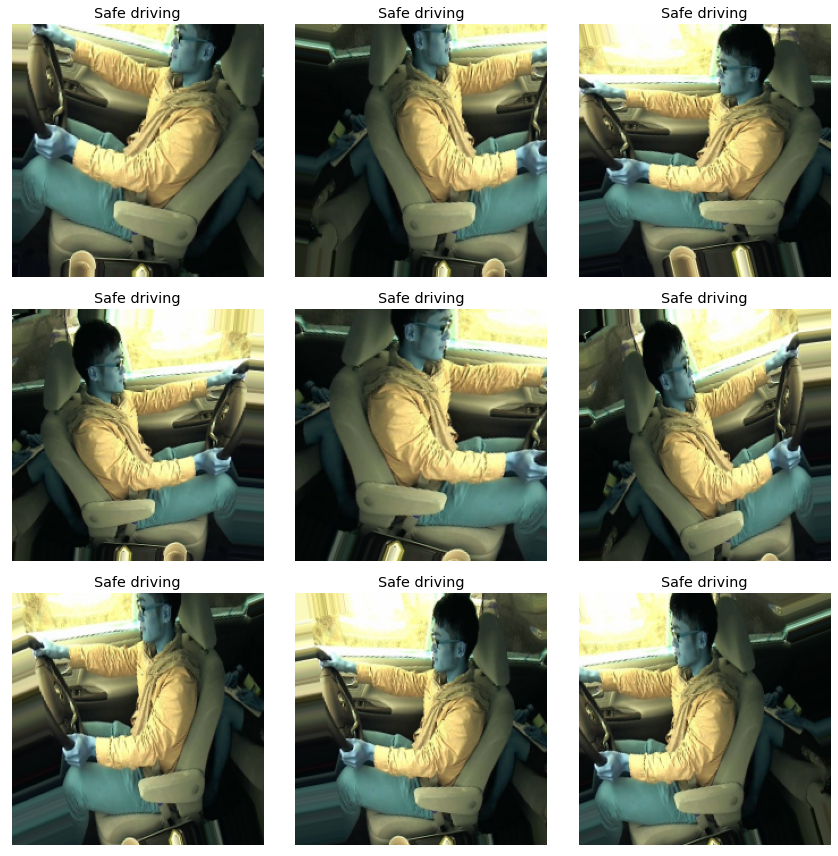

In [719]:
train_one_image_generator= train_datagen_augmentation.flow(
    img,
    y_1,
    batch_size=32
)

plt.figure(figsize=(12, 12))
for i in range(0, 9):
    plt.subplot(3, 3, i+1)
    for X_batch, Y_batch in train_one_image_generator:
        image = X_batch[0]
        plt.imshow(image)
        plt.yticks([])
        plt.xticks([])
        plt.title(activity_map.get("c"+str(int(np.argmax(Y_batch[0])))))
        break
plt.tight_layout()
plt.show()

Building the Train,validation and test sets

In [741]:
train_generator_augmentation=train_datagen_augmentation.flow_from_directory(
    directory=train_path,
    target_size=(224, 224),
    batch_size=batchs,
    class_mode="categorical",
    shuffle=True
)

valid_generator_augmentation=test_datagen_augmentation.flow_from_directory(
    directory=valid_path,
    target_size=(224, 224),
    batch_size=batchs,
    class_mode="categorical",
    shuffle=True
)


test_generator_augmentation=test_datagen_augmentation.flow_from_directory(
    directory=test_path,
    target_size=(224, 224),
    batch_size=1,
    class_mode="categorical",
    shuffle=True
)

test_generator_augmentation_cm=test_datagen_augmentation.flow_from_directory(
    directory=test_path,
    target_size=(224, 224),
    batch_size=1,
    class_mode="categorical",
    shuffle=False
)

Found 13448 images belonging to 10 classes.
Found 5377 images belonging to 10 classes.
Found 3578 images belonging to 10 classes.
Found 3578 images belonging to 10 classes.


### 3.2.1 Base Line Model <a class="anchor" id="section_3_2_1"></a>

Same model as above with 2 more layers added.

In [237]:
dense_model_2=models.Sequential()
dense_model_2.add(layers.Flatten(input_shape=(224,224,3)))
dense_model_2.add(layers.Dense(1024, activation='relu', name='Layer_1'))
dense_model_2.add(layers.Dense(512, activation='relu', name='Layer_2'))
dense_model_2.add(layers.Dense(512, activation='relu', name='Layer_3'))
dense_model_2.add(layers.Dense(256, activation='relu', name='Layer_4'))
dense_model_2.add(layers.Dense(256, activation='relu', name='Layer_5'))
dense_model_2.add(layers.Dense(128, activation='relu', name='Layer_6'))
dense_model_2.add(layers.Dense(128, activation='relu', name='Layer_7'))
dense_model_2.add(layers.Dense(10, activation='softmax',name='final_layer'))
dense_model_2.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_7 (Flatten)         (None, 150528)            0         
                                                                 
 Layer_1 (Dense)             (None, 1024)              154141696 
                                                                 
 Layer_2 (Dense)             (None, 512)               524800    
                                                                 
 Layer_3 (Dense)             (None, 512)               262656    
                                                                 
 Layer_4 (Dense)             (None, 256)               131328    
                                                                 
 Layer_5 (Dense)             (None, 256)               65792     
                                                                 
 Layer_6 (Dense)             (None, 128)              

In [238]:
dense_model_2.compile(optimizer=keras.optimizers.Adam(),
                loss='categorical_crossentropy',
                metrics=['accuracy'])

In [239]:
history_5=dense_model_2.fit(train_generator_augmentation,
                          validation_data=valid_generator_augmentation,
                          epochs=10, 
                          verbose=1,
                          callbacks=callbacks_)

Epoch 1/10
421/421 [==============================] - 343s 813ms/step - loss: 3.0973 - accuracy: 0.1164 - val_loss: 2.2366 - val_accuracy: 0.1821
Epoch 2/10
421/421 [==============================] - 340s 809ms/step - loss: 2.2624 - accuracy: 0.1519 - val_loss: 2.1731 - val_accuracy: 0.1953
Epoch 3/10
421/421 [==============================] - 1558s 4s/step - loss: 2.2087 - accuracy: 0.1676 - val_loss: 2.0908 - val_accuracy: 0.2351
Epoch 4/10
421/421 [==============================] - 352s 837ms/step - loss: 2.1470 - accuracy: 0.1952 - val_loss: 1.9248 - val_accuracy: 0.2591
Epoch 5/10
421/421 [==============================] - 312s 740ms/step - loss: 2.0750 - accuracy: 0.2215 - val_loss: 1.8064 - val_accuracy: 0.2953
Epoch 6/10
421/421 [==============================] - 322s 765ms/step - loss: 2.0361 - accuracy: 0.2342 - val_loss: 1.7974 - val_accuracy: 0.3028
Epoch 7/10
421/421 [==============================] - 316s 751ms/step - loss: 1.9763 - accuracy: 0.2538 - val_loss: 1.7786 - v

In [240]:
test_loss, test_acc = dense_model_2.evaluate(test_generator_augmentation)

3578/3578 [==============================] - 126s 35ms/step - loss: 1.6631 - accuracy: 0.3390


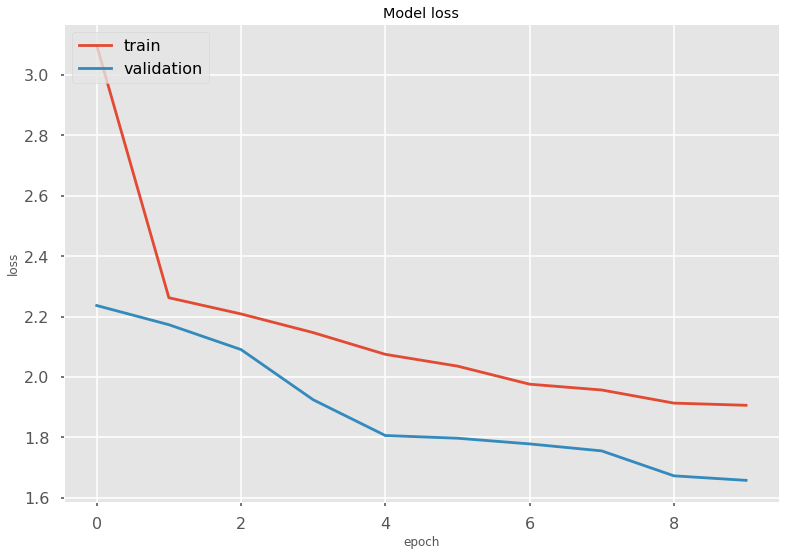

In [399]:
loss_plot(history_5)

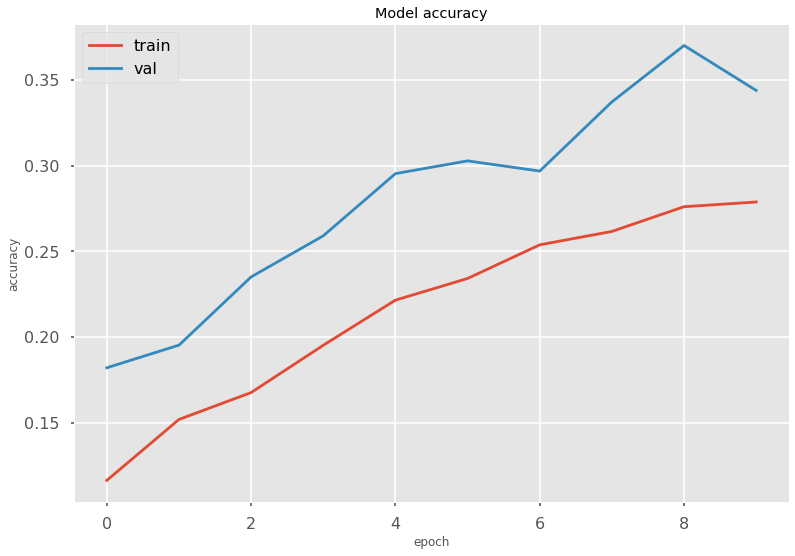

In [400]:
acc_plot(history_5)

[[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]]
1/1 [==============================] - 2s 2s/step
[[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 45ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
1/1 [==============================] - 0s 47ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
1/1 [==============================] - 0s 49ms/step
[[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 51ms/step
[[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 48ms/step
[[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 48ms/step
[[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 50ms/step
[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 49ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
1/1 [==============================] - 0s 49ms/step
[[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 53ms/step
[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [=================

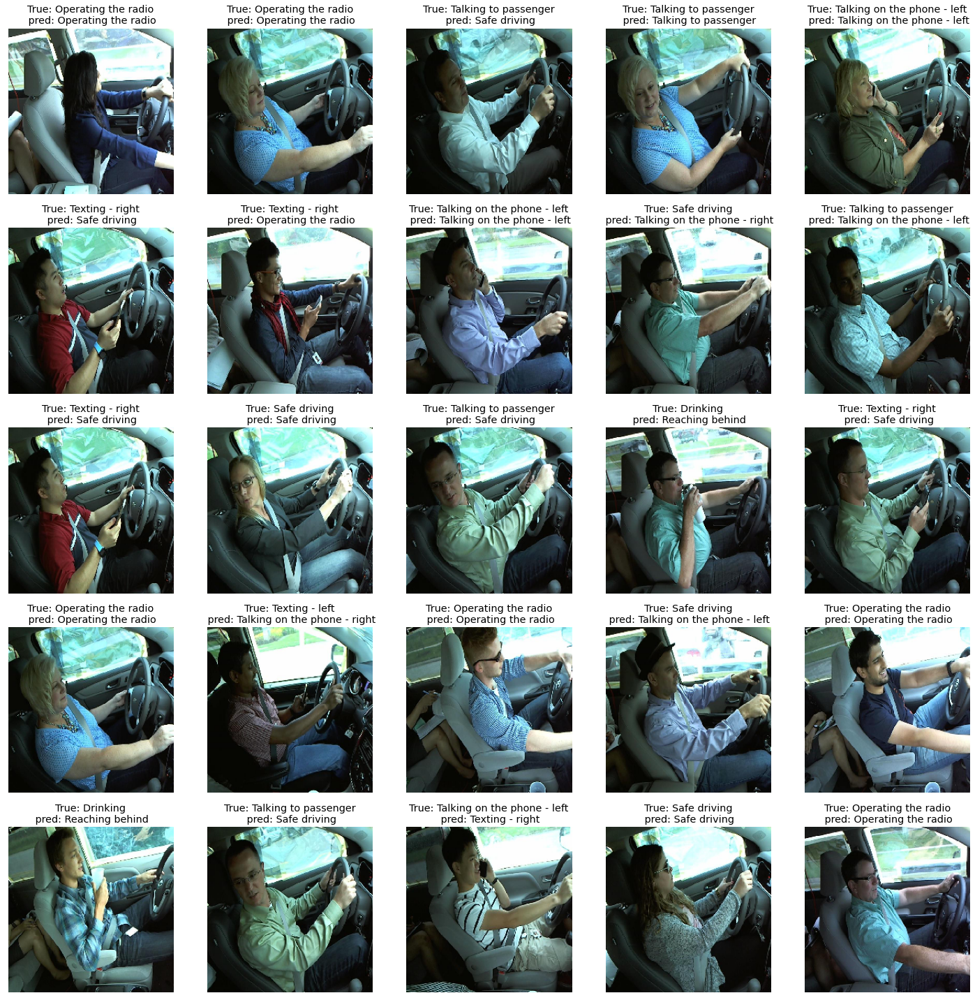

In [722]:
plot_res(dense_model_2,test_generator_augmentation)

3578/3578 [==============================] - 152s 43ms/step
              precision    recall  f1-score   support

          c0       0.37      0.33      0.35       392
          c1       0.25      0.24      0.25       375
          c2       0.31      0.23      0.26       355
          c3       0.33      0.04      0.07       366
          c4       0.27      0.59      0.38       360
          c5       0.67      0.88      0.76       373
          c6       0.00      0.00      0.00       379
          c7       0.26      0.81      0.39       313
          c8       0.27      0.10      0.15       332
          c9       0.38      0.22      0.28       333

    accuracy                           0.34      3578
   macro avg       0.31      0.34      0.29      3578
weighted avg       0.31      0.34      0.29      3578



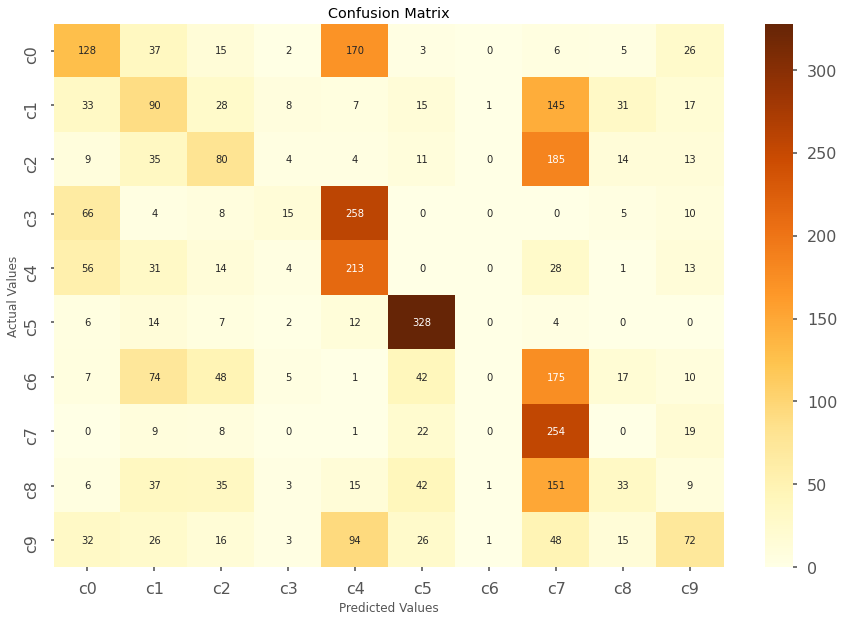

In [825]:
matrix_and_report(dense_model_2,test_generator_augmentation_cm)

### 3.2.2 CNN <a class="anchor" id="section_3_2_2"></a>

Same Model as Above 

In [247]:
cnn_model_2 = models.Sequential()

cnn_model_2.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224,3)))
cnn_model_2.add(layers.MaxPooling2D((2, 2)))

cnn_model_2.add(layers.Conv2D(64, (3, 3), activation='relu'))
cnn_model_2.add(layers.MaxPooling2D((2, 2)))

cnn_model_2.add(layers.Conv2D(128, (3, 3), activation='relu'))
cnn_model_2.add(layers.MaxPooling2D((2, 2)))

cnn_model_2.add(layers.Conv2D(128, (3, 3), activation='relu'))
cnn_model_2.add(layers.MaxPooling2D((2, 2)))

cnn_model_2.add(layers.Flatten())
cnn_model_2.add(layers.Dense(128, activation='relu'))
cnn_model_2.add(layers.Dense(10, activation='softmax'))
cnn_model_2.summary()


Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_22 (Conv2D)          (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d_19 (MaxPoolin  (None, 111, 111, 32)     0         
 g2D)                                                            
                                                                 
 conv2d_23 (Conv2D)          (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_20 (MaxPoolin  (None, 54, 54, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_24 (Conv2D)          (None, 52, 52, 128)       73856     
                                                                 
 max_pooling2d_21 (MaxPoolin  (None, 26, 26, 128)    

In [248]:
cnn_model_2.compile(optimizer=keras.optimizers.Adam(),
                loss='categorical_crossentropy',
                metrics=['accuracy'])

In [249]:
history_6=cnn_model_2.fit(train_generator_augmentation,
                          validation_data=valid_generator_augmentation,
                          epochs=10, 
                          verbose=1,
                          callbacks=callbacks_)

Epoch 1/10
421/421 [==============================] - 445s 1s/step - loss: 2.2336 - accuracy: 0.1502 - val_loss: 1.8589 - val_accuracy: 0.2974
Epoch 2/10
421/421 [==============================] - 438s 1s/step - loss: 1.5129 - accuracy: 0.4478 - val_loss: 0.8796 - val_accuracy: 0.6727
Epoch 3/10
421/421 [==============================] - 642s 2s/step - loss: 0.9662 - accuracy: 0.6595 - val_loss: 0.4516 - val_accuracy: 0.8414
Epoch 4/10
421/421 [==============================] - 439s 1s/step - loss: 0.6509 - accuracy: 0.7797 - val_loss: 0.2649 - val_accuracy: 0.9176
Epoch 5/10
421/421 [==============================] - 1465s 3s/step - loss: 0.4862 - accuracy: 0.8389 - val_loss: 0.2208 - val_accuracy: 0.9282
Epoch 6/10
421/421 [==============================] - 45062s 107s/step - loss: 0.3979 - accuracy: 0.8655 - val_loss: 0.2349 - val_accuracy: 0.9262
Epoch 7/10
421/421 [==============================] - 446s 1s/step - loss: 0.3451 - accuracy: 0.8861 - val_loss: 0.1614 - val_accuracy: 0

In [251]:
test_loss, test_acc = cnn_model_2.evaluate(test_generator_augmentation)

3578/3578 [==============================] - 36s 10ms/step - loss: 0.1338 - accuracy: 0.9578


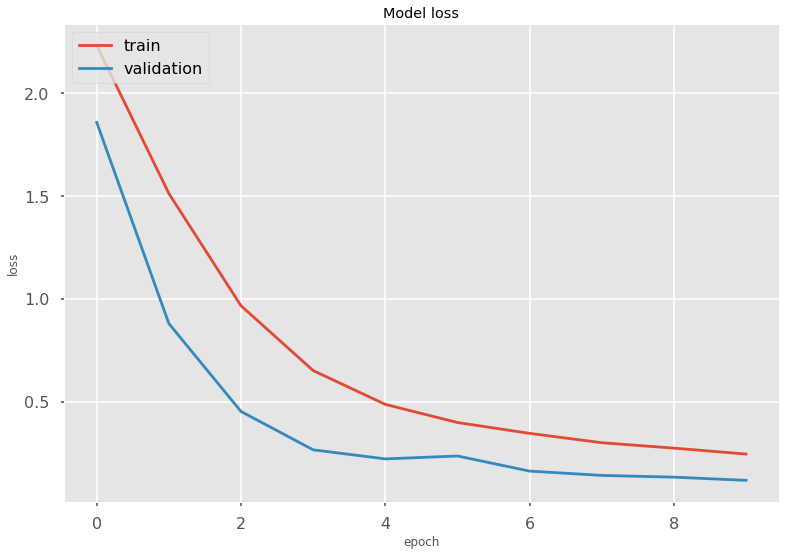

In [402]:
loss_plot(history_6)

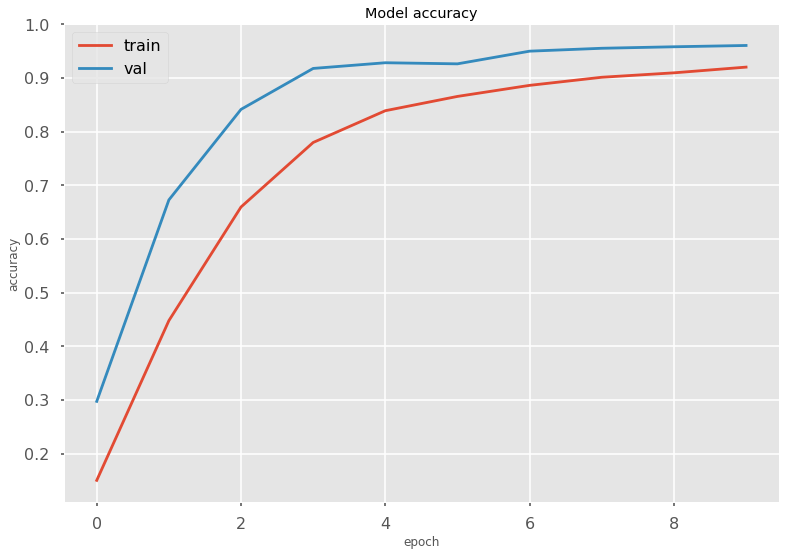

In [403]:
acc_plot(history_6)

[[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 52ms/step
[[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 20ms/step
[[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 21ms/step
[[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
1/1 [==============================] - 0s 23ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
1/1 [==============================] - 0s 24ms/step
[[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 23ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]]
1/1 [==============================] - 0s 24ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
1/1 [==============================] - 0s 24ms/step
[[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 25ms/step
[[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 23ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
1/1 [==============================] - 0s 23ms/step
[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [===============

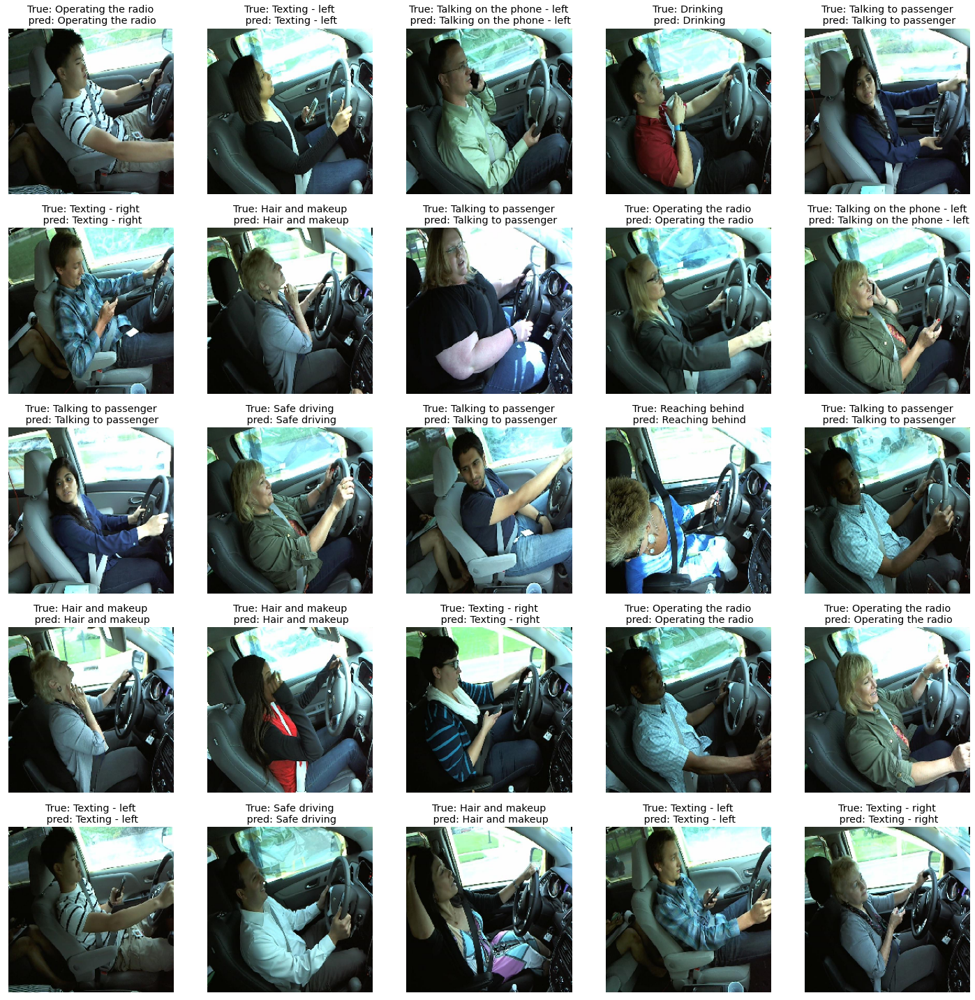

In [723]:
plot_res(cnn_model_2,test_generator_augmentation)

3578/3578 [==============================] - 39s 11ms/step
              precision    recall  f1-score   support

          c0       0.89      0.95      0.92       392
          c1       0.98      0.98      0.98       375
          c2       0.95      1.00      0.98       355
          c3       1.00      0.98      0.99       366
          c4       0.96      0.99      0.97       360
          c5       0.97      0.99      0.98       373
          c6       0.97      0.96      0.97       379
          c7       0.96      0.99      0.98       313
          c8       0.96      0.88      0.92       332
          c9       0.94      0.84      0.89       333

    accuracy                           0.96      3578
   macro avg       0.96      0.96      0.96      3578
weighted avg       0.96      0.96      0.96      3578



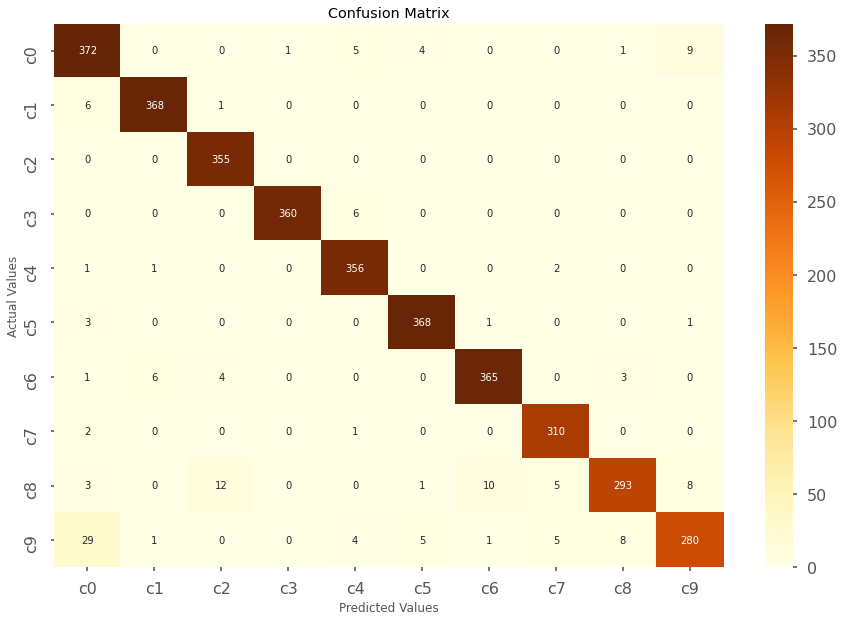

In [826]:
matrix_and_report(cnn_model_2,test_generator_augmentation_cm)

### 3.3 Transfer Learning <a class="anchor" id="section_3_3"></a>

After attempting Basic models with and without data augmentation, it is now time to try pre-trained models; we may get more accuracy.

### 3.3.1 Mobile Net  <a class="anchor" id="section_3_3_1"></a>

In [290]:
mobilenet_model = 'https://tfhub.dev/google/tf2-preview/mobilenet_v2/feature_vector/3'

pretrained_model = hub.KerasLayer(mobilenet_model, input_shape=(224,224,3), trainable=False)

In [880]:
num_of_classes = 10

mobilenet = tf.keras.Sequential([
    pretrained_model,
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dense(num_of_classes, activation='softmax')
])
mobilenet.summary()


Model: "sequential_25"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_6 (KerasLayer)  (None, 1280)              2257984   
                                                                 
 dense_41 (Dense)            (None, 128)               163968    
                                                                 
 dense_42 (Dense)            (None, 10)                1290      
                                                                 
Total params: 2,423,242
Trainable params: 165,258
Non-trainable params: 2,257,984
_________________________________________________________________


In [882]:
mobilenet.compile(optimizer=keras.optimizers.Adam(),
                loss='categorical_crossentropy',
                metrics=['accuracy'])

In [883]:
history_7=mobilenet.fit(train_generator_augmentation,
                          validation_data=valid_generator_augmentation,
                          epochs=10, 
                          verbose=1,
                          callbacks=callbacks_)

Epoch 1/10
421/421 [==============================] - 317s 747ms/step - loss: 1.2396 - accuracy: 0.5829 - val_loss: 0.7524 - val_accuracy: 0.7437
Epoch 2/10
421/421 [==============================] - 300s 712ms/step - loss: 0.6858 - accuracy: 0.7755 - val_loss: 0.5315 - val_accuracy: 0.8322
Epoch 3/10
421/421 [==============================] - 299s 711ms/step - loss: 0.5569 - accuracy: 0.8167 - val_loss: 0.5265 - val_accuracy: 0.8229
Epoch 4/10
421/421 [==============================] - 301s 714ms/step - loss: 0.4997 - accuracy: 0.8328 - val_loss: 0.3765 - val_accuracy: 0.8841
Epoch 5/10
421/421 [==============================] - 296s 702ms/step - loss: 0.4384 - accuracy: 0.8533 - val_loss: 0.4742 - val_accuracy: 0.8497
Epoch 6/10
421/421 [==============================] - 713s 2s/step - loss: 0.4078 - accuracy: 0.8639 - val_loss: 0.3913 - val_accuracy: 0.8724
Epoch 7/10
421/421 [==============================] - 310s 737ms/step - loss: 0.3929 - accuracy: 0.8699 - val_loss: 0.5576 - va

In [884]:
test_loss, test_acc = mobilenet.evaluate(test_generator_augmentation)

3578/3578 [==============================] - 132s 37ms/step - loss: 0.5921 - accuracy: 0.8044


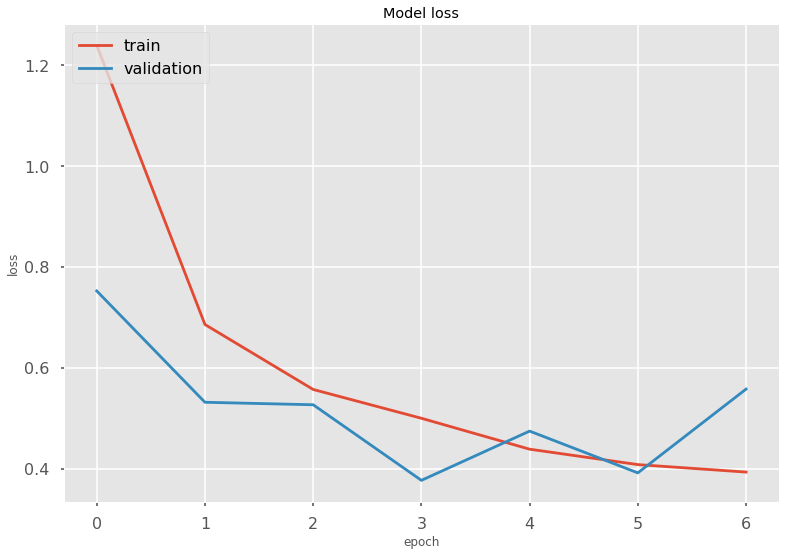

In [885]:
loss_plot(history_7)

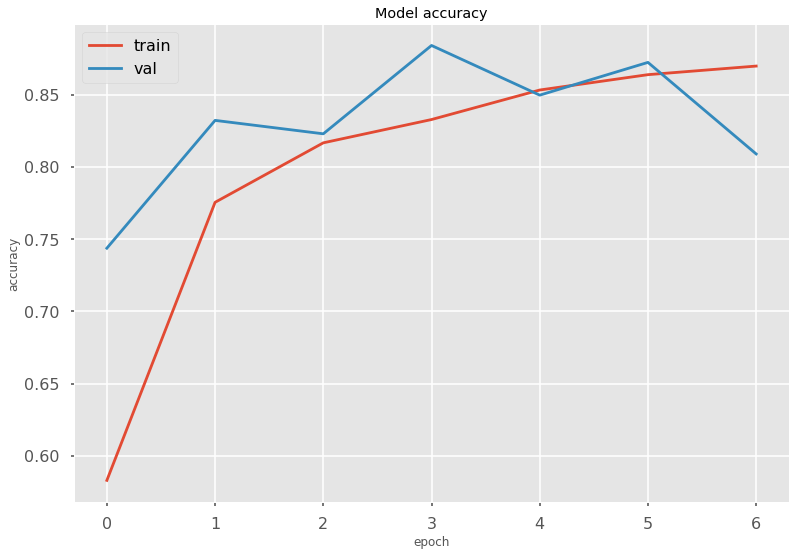

In [886]:
acc_plot(history_7)

[[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
1/1 [==============================] - 1s 633ms/step
[[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]]
1/1 [==============================] - 0s 59ms/step
[[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
1/1 [==============================] - 0s 55ms/step
[[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
1/1 [==============================] - 0s 65ms/step
[[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 60ms/step
[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 59ms/step
[[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 57ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
1/1 [==============================] - 0s 58ms/step
[[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
1/1 [==============================] - 0s 58ms/step
[[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 65ms/step
[[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]]
1/1 [==============================] - 0s 63ms/step
[[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]]
1/1 [==============

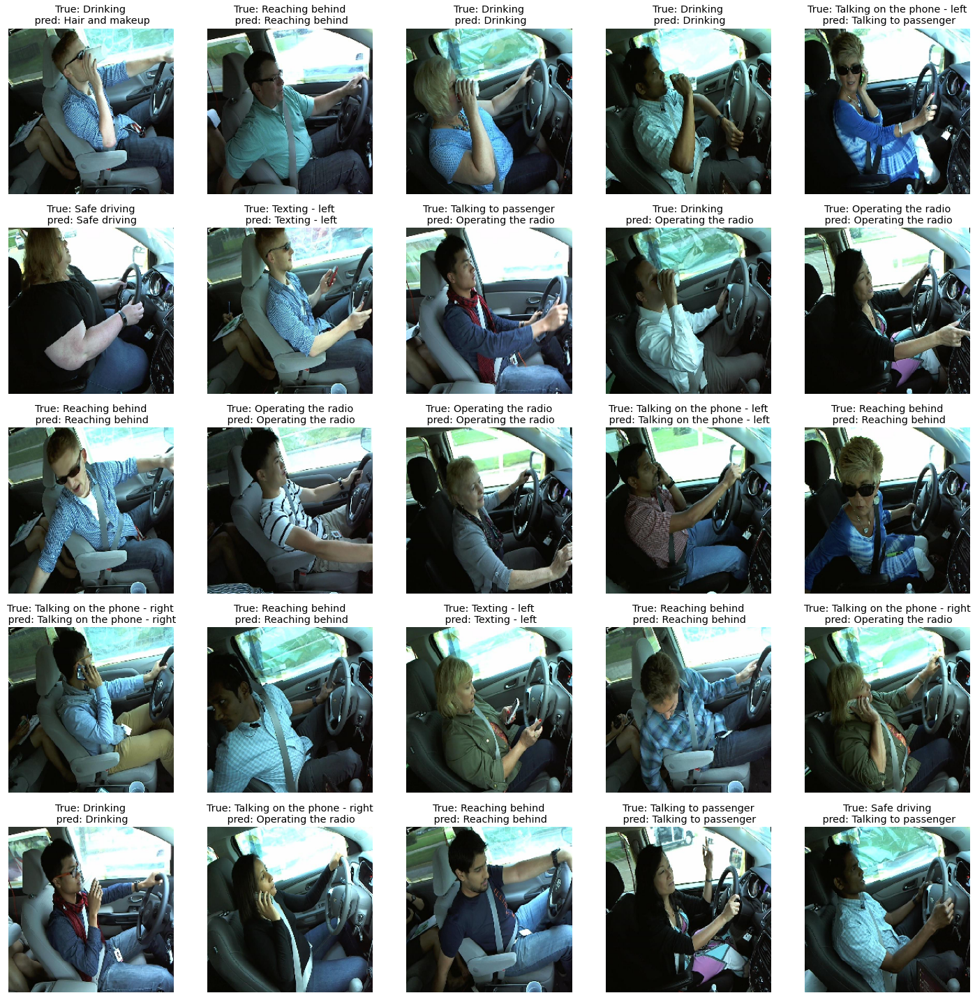

In [887]:
plot_res(mobilenet,test_generator_augmentation)

3578/3578 [==============================] - 145s 40ms/step
              precision    recall  f1-score   support

          c0       0.91      0.69      0.78       392
          c1       0.82      0.87      0.85       375
          c2       0.81      0.85      0.83       355
          c3       0.85      0.94      0.89       366
          c4       0.93      0.84      0.89       360
          c5       0.56      1.00      0.71       373
          c6       0.98      0.59      0.74       379
          c7       0.87      0.92      0.89       313
          c8       0.87      0.50      0.63       332
          c9       0.79      0.85      0.82       333

    accuracy                           0.80      3578
   macro avg       0.84      0.80      0.80      3578
weighted avg       0.84      0.80      0.80      3578



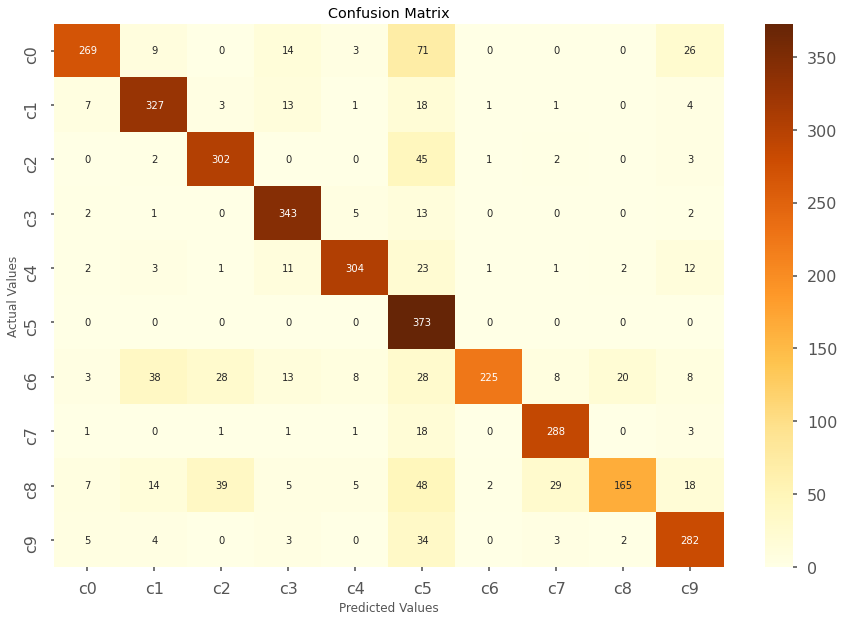

In [888]:
matrix_and_report(mobilenet,test_generator_augmentation_cm)

### 3.3.2  ResNet  <a class="anchor" id="section_3_3_2"></a>

Utilizing ResNet's preprocess input function for data augmentation

In [725]:
train_datagen_resnet = ImageDataGenerator(
    preprocessing_function=preprocess_input,
    shear_range=0.1,
    horizontal_flip=True,
    width_shift_range=0.1,
    height_shift_range=0.1,
    rotation_range=20,
    fill_mode='nearest'
)

test_datagen_resnet = ImageDataGenerator(preprocessing_function=preprocess_input)

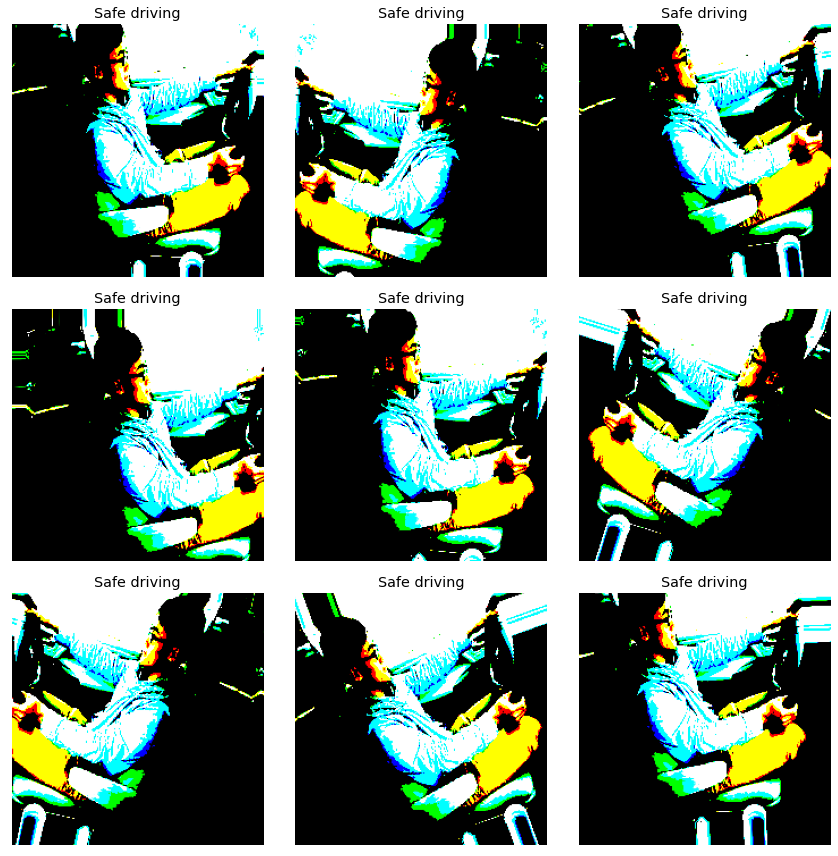

In [740]:
train_one_image_generator= train_datagen_resnet.flow(
    img,
    y_1,
    batch_size=32
)

plt.figure(figsize=(12, 12))
for i in range(0, 9):
    plt.subplot(3, 3, i+1)
    for X_batch, Y_batch in train_one_image_generator:
        image = X_batch[0]
        plt.imshow(image)
        plt.yticks([])
        plt.xticks([])
        plt.title(activity_map.get("c"+str(int(np.argmax(Y_batch[0])))))
        break
plt.tight_layout()
plt.show()

In [743]:
train_generator_resnet=train_datagen_resnet.flow_from_directory(
    directory=train_path,
    target_size=(224, 224),
    batch_size=batchs,
    class_mode="categorical",
    shuffle=True
)

valid_generator_resnet=test_datagen_resnet.flow_from_directory(
    directory=valid_path,
    target_size=(224, 224),
    batch_size=batchs,
    class_mode="categorical",
    shuffle=True
)


test_generator_resnet=test_datagen_resnet.flow_from_directory(
    directory=test_path,
    target_size=(224, 224),
    batch_size=1,
    class_mode="categorical",
    shuffle=True
)

test_generator_resnet_cm=test_datagen_resnet.flow_from_directory(
    directory=test_path,
    target_size=(224, 224),
    batch_size=1,
    class_mode="categorical",
    shuffle=False
)

Found 13448 images belonging to 10 classes.
Found 5377 images belonging to 10 classes.
Found 3578 images belonging to 10 classes.
Found 3578 images belonging to 10 classes.


In [890]:
conv_Res = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
conv_Res.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_8 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_8[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

In [306]:
conv_Res.trainable=False


In [308]:
res_model_3 = models.Sequential()
res_model_3.add(conv_Res)
res_model_3.add(layers.Flatten())
res_model_3.add(layers.Dense(128, activation='relu'))
res_model_3.add(layers.Dense(64, activation='relu'))
res_model_3.add(layers.Dense(10, activation='softmax'))
res_model_3.summary()


Model: "sequential_21"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 flatten_10 (Flatten)        (None, 100352)            0         
                                                                 
 dense_22 (Dense)            (None, 128)               12845184  
                                                                 
 dense_23 (Dense)            (None, 64)                8256      
                                                                 
 dense_24 (Dense)            (None, 10)                650       
                                                                 
Total params: 36,441,802
Trainable params: 12,854,090
Non-trainable params: 23,587,712
_________________________________________________________________


In [309]:
res_model_3.compile(optimizer=keras.optimizers.Adam(),
                loss='categorical_crosentropy',
                metrics=['accuracy'])

In [311]:
history_8=res_model_3.fit(train_generator_resnet,
                          validation_data=valid_generator_resnet,
                          epochs=10, 
                          verbose=1,
                          callbacks=callbacks_)

Epoch 1/10
421/421 [==============================] - 791s 2s/step - loss: 1.8380 - accuracy: 0.6818 - val_loss: 0.5238 - val_accuracy: 0.8696
Epoch 2/10
421/421 [==============================] - 771s 2s/step - loss: 0.6246 - accuracy: 0.8485 - val_loss: 0.2885 - val_accuracy: 0.9273
Epoch 3/10
421/421 [==============================] - 758s 2s/step - loss: 0.3807 - accuracy: 0.8966 - val_loss: 0.2638 - val_accuracy: 0.9277
Epoch 4/10
421/421 [==============================] - 758s 2s/step - loss: 0.3005 - accuracy: 0.9136 - val_loss: 0.1514 - val_accuracy: 0.9589
Epoch 5/10
421/421 [==============================] - 766s 2s/step - loss: 0.2865 - accuracy: 0.9189 - val_loss: 0.1659 - val_accuracy: 0.9550
Epoch 6/10
421/421 [==============================] - 768s 2s/step - loss: 0.2565 - accuracy: 0.9244 - val_loss: 0.2331 - val_accuracy: 0.9351
Epoch 7/10
421/421 [==============================] - 761s 2s/step - loss: 0.2646 - accuracy: 0.9246 - val_loss: 0.2576 - val_accuracy: 0.9329

In [312]:
test_loss, test_acc = res_model_3.evaluate(test_generator_resnet)


3578/3578 [==============================] - 264s 74ms/step - loss: 0.2960 - accuracy: 0.9290


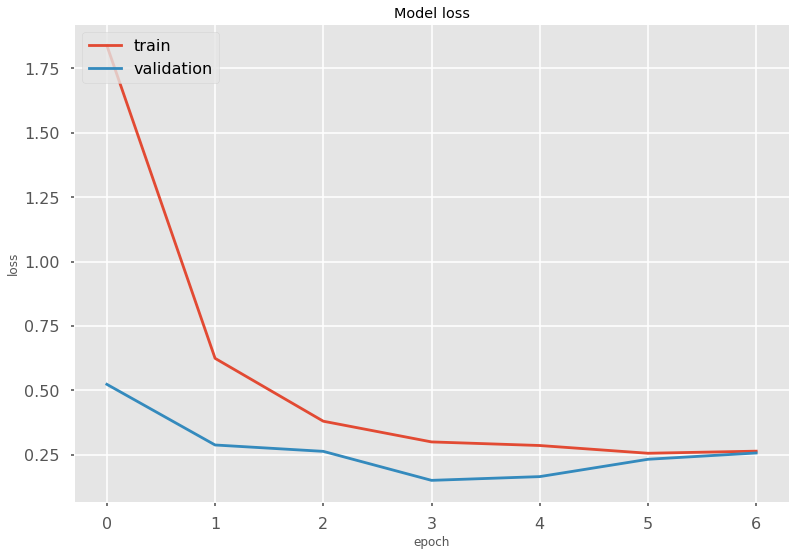

In [379]:
loss_plot(history_8)

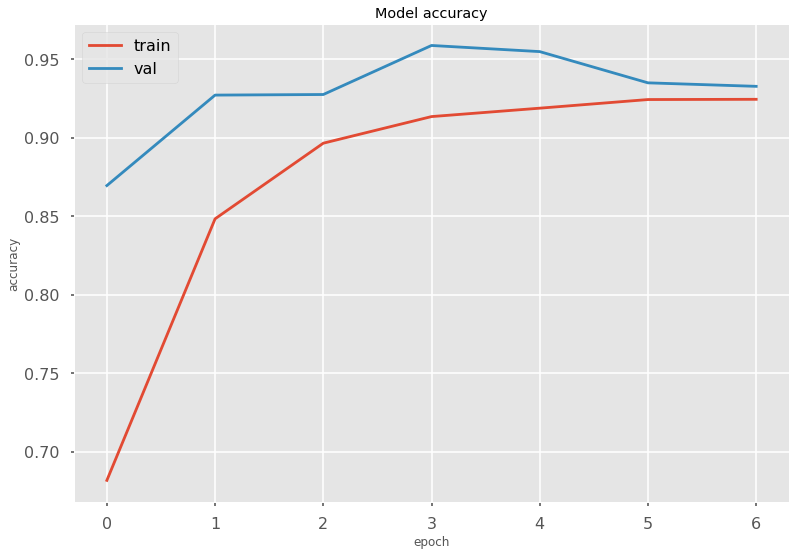

In [382]:
acc_plot(history_8)

[[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 85ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
1/1 [==============================] - 0s 77ms/step
[[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 89ms/step
[[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 86ms/step
[[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 87ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]]
1/1 [==============================] - 0s 86ms/step
[[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 87ms/step
[[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 88ms/step
[[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 104ms/step
[[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
1/1 [==============================] - 0s 93ms/step
[[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 91ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
1/1 [==============

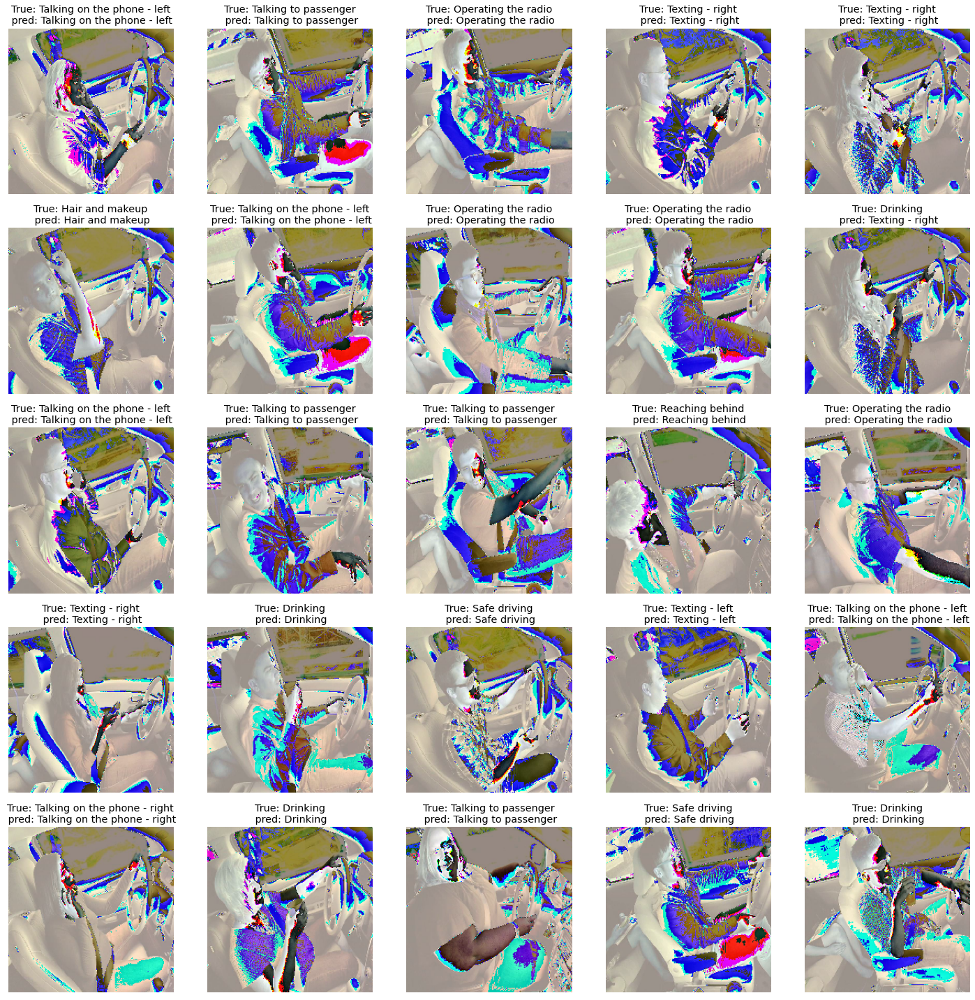

In [746]:
plot_res_res(res_model_3,test_generator_resnet)

3578/3578 [==============================] - 279s 78ms/step
              precision    recall  f1-score   support

          c0       0.84      0.90      0.87       392
          c1       0.96      0.97      0.96       375
          c2       0.98      1.00      0.99       355
          c3       0.82      0.98      0.89       366
          c4       0.95      0.98      0.97       360
          c5       0.97      0.98      0.97       373
          c6       0.99      0.94      0.96       379
          c7       1.00      0.98      0.99       313
          c8       0.98      0.94      0.96       332
          c9       0.99      0.75      0.85       333

    accuracy                           0.94      3578
   macro avg       0.95      0.94      0.94      3578
weighted avg       0.95      0.94      0.94      3578



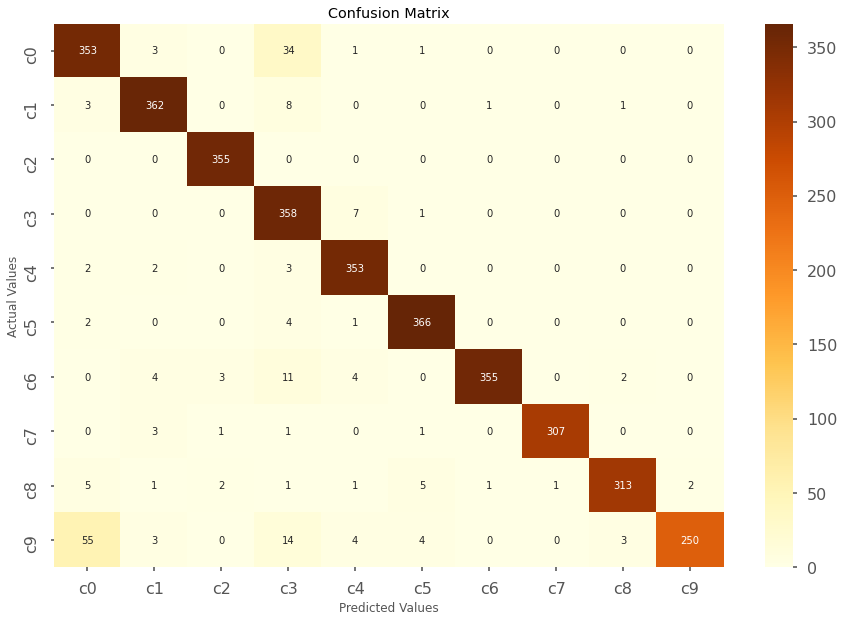

In [828]:
matrix_and_report(res_model_3,test_generator_resnet_cm)

### 3.3.3 ResNet Fine-Tuning  <a class="anchor" id="section_3_3_3"></a>

In [426]:
conv_Res.trainable = True

In [428]:
set_trainable = False
for layer in conv_Res.layers:
    if (layer.name).startswith('conv5_block3_3_bn'):
      set_trainable = True
    if set_trainable:
        layer.trainable = True
    else:
        layer.trainable = False

True
True
True


In [431]:
res_model_4 = models.Sequential()
res_model_4.add(conv_Res)
res_model_4.add(layers.Flatten())
res_model_4.add(layers.Dropout(0.7))
res_model_4.add(layers.Dense(128, activation='relu'))
res_model_4.add(layers.Dense(64, activation='relu'))
res_model_4.add(layers.Dense(10, activation='softmax'))
res_model_4.summary()


Model: "sequential_24"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 flatten_12 (Flatten)        (None, 100352)            0         
                                                                 
 dropout_6 (Dropout)         (None, 100352)            0         
                                                                 
 dense_28 (Dense)            (None, 128)               12845184  
                                                                 
 dense_29 (Dense)            (None, 64)                8256      
                                                                 
 dense_30 (Dense)            (None, 10)                650       
                                                                 
Total params: 36,441,802
Trainable params: 12,858,186

In [433]:
res_model_4.compile(optimizer=keras.optimizers.Adam(),
                loss='categorical_crossentropy',
                metrics=['accuracy'])

In [434]:
history_8=res_model_4.fit(train_generator_resnet,
                          validation_data=valid_generator_resnet,
                          epochs=10, 
                          verbose=1,
                          callbacks=callbacks_)

Epoch 1/10
421/421 [==============================] - 833s 2s/step - loss: 1.7067 - accuracy: 0.5959 - val_loss: 0.3641 - val_accuracy: 0.8720
Epoch 2/10
421/421 [==============================] - 814s 2s/step - loss: 0.6495 - accuracy: 0.7974 - val_loss: 0.2855 - val_accuracy: 0.9085
Epoch 3/10
421/421 [==============================] - 784s 2s/step - loss: 0.5050 - accuracy: 0.8421 - val_loss: 0.1999 - val_accuracy: 0.9325
Epoch 4/10
421/421 [==============================] - 806s 2s/step - loss: 0.4392 - accuracy: 0.8601 - val_loss: 0.1964 - val_accuracy: 0.9403
Epoch 5/10
421/421 [==============================] - 825s 2s/step - loss: 0.4015 - accuracy: 0.8749 - val_loss: 0.1754 - val_accuracy: 0.9450
Epoch 6/10
421/421 [==============================] - 774s 2s/step - loss: 0.3797 - accuracy: 0.8780 - val_loss: 0.1164 - val_accuracy: 0.9635
Epoch 7/10
421/421 [==============================] - 778s 2s/step - loss: 0.3634 - accuracy: 0.8832 - val_loss: 0.1193 - val_accuracy: 0.9615

In [435]:
test_loss, test_acc = res_model_4.evaluate(test_generator_resnet)

3578/3578 [==============================] - 303s 85ms/step - loss: 0.1540 - accuracy: 0.9570


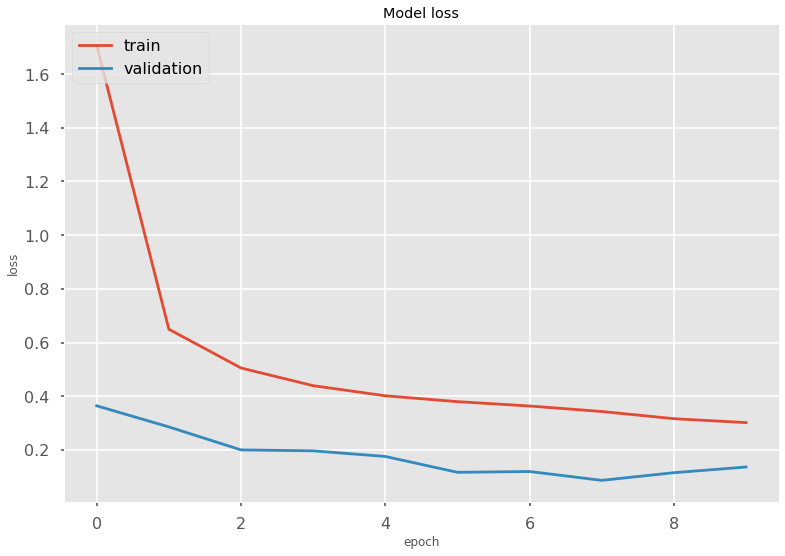

In [436]:
loss_plot(history_8)

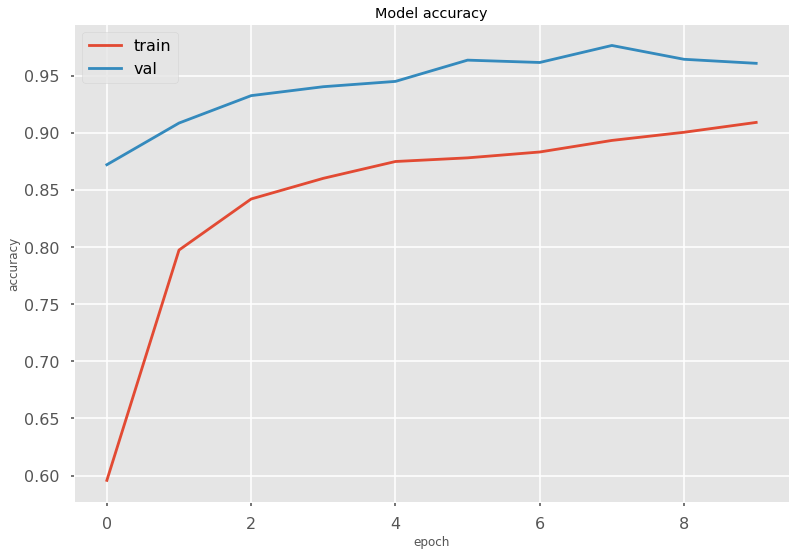

In [437]:
acc_plot(history_8)

[[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 80ms/step
[[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 73ms/step
[[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 83ms/step
[[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 92ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
1/1 [==============================] - 0s 90ms/step
[[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 88ms/step
[[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 88ms/step
[[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 91ms/step
[[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
1/1 [==============================] - 0s 87ms/step
[[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
1/1 [==============================] - 0s 112ms/step
[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 94ms/step
[[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
1/1 [==============

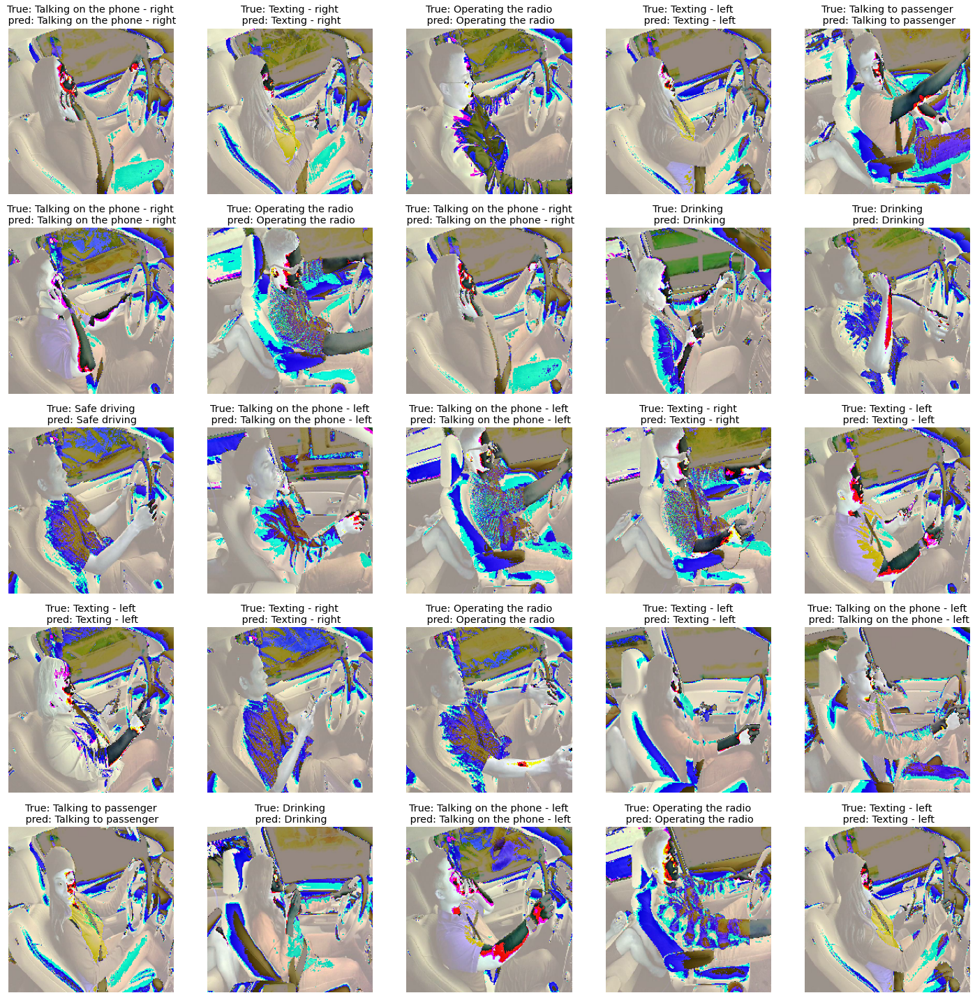

In [748]:
plot_res_res(res_model_4,test_generator_resnet)

3578/3578 [==============================] - 274s 76ms/step
              precision    recall  f1-score   support

          c0       0.89      0.97      0.93       392
          c1       0.99      0.95      0.97       375
          c2       0.99      0.99      0.99       355
          c3       0.95      0.98      0.96       366
          c4       0.99      0.93      0.96       360
          c5       1.00      0.99      0.99       373
          c6       0.98      0.97      0.97       379
          c7       0.99      0.98      0.99       313
          c8       0.99      0.84      0.91       332
          c9       0.84      0.97      0.90       333

    accuracy                           0.96      3578
   macro avg       0.96      0.96      0.96      3578
weighted avg       0.96      0.96      0.96      3578



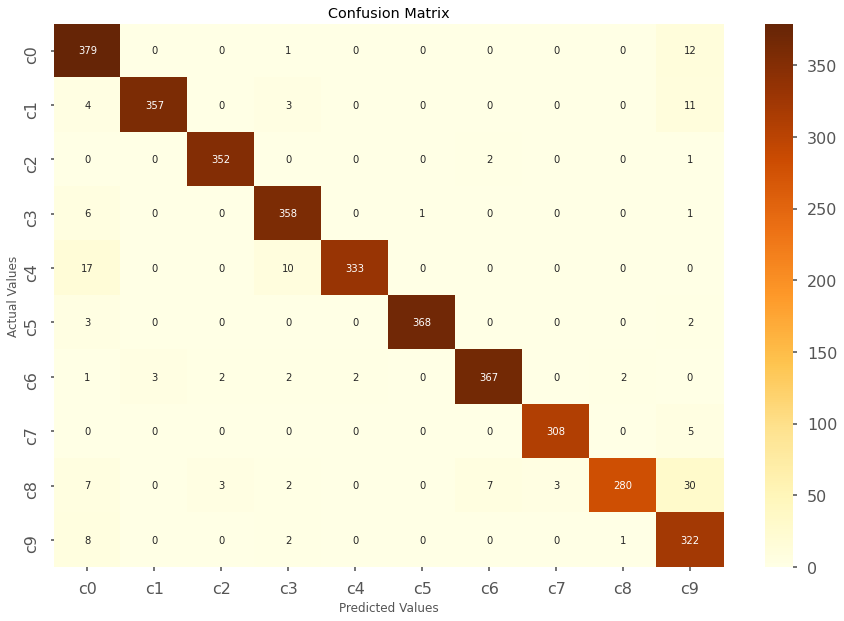

In [829]:
matrix_and_report(res_model_4,test_generator_resnet_cm)

### 3.3.4 VGG16  <a class="anchor" id="section_3_3_4"></a>

In [893]:
inpu = keras.layers.Input(shape=(224, 224, 3))
vgg = VGG16(weights='imagenet',
              include_top=False,
              input_tensor = inp,
              input_shape=(224, 224, 3))
vgg.trainable = False

x = vgg.get_layer('block5_pool').output
x = tf.keras.layers.Flatten()(x)
x = keras.layers.Dense(256, activation='relu')(x)
output = keras.layers.Dense(10, activation='softmax')(x)

model = tf.keras.models.Model(inputs = inpu, outputs=output)

In [892]:
vgg16 = model
vgg16.summary()

Model: "model_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_9 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

In [875]:
vgg16.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
                loss='categorical_crossentropy',
                metrics=['accuracy'])

In [876]:
early_stopping = keras.callbacks.EarlyStopping(
    monitor='val_loss',
    min_delta=0.0001,
    patience=3,
    verbose=1,
    mode='min',
    baseline=None,
    restore_best_weights=True
)

In [877]:
history_9 = vgg16.fit(train_generator_augmentation,
                          validation_data=test_generator_augmentation, 
                          epochs=10, 
                          verbose = 1,
                          callbacks= early_stopping)

C:\Users\Mostafa\anaconda3\lib\site-packages\keras\preprocessing\image.py:1863: UserWarning: This ImageDataGenerator specifies `featurewise_center`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn(
C:\Users\Mostafa\anaconda3\lib\site-packages\keras\preprocessing\image.py:1873: UserWarning: This ImageDataGenerator specifies `featurewise_std_normalization`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn(


Epoch 1/10
421/421 [==============================] - 1149s 3s/step - loss: 1.2910 - accuracy: 0.6028 - val_loss: 0.4911 - val_accuracy: 0.8787
Epoch 2/10
421/421 [==============================] - 1070s 3s/step - loss: 0.5758 - accuracy: 0.8543 - val_loss: 0.2377 - val_accuracy: 0.9514
Epoch 3/10
421/421 [==============================] - 2009s 5s/step - loss: 0.3940 - accuracy: 0.9015 - val_loss: 0.1769 - val_accuracy: 0.9575
Epoch 4/10
421/421 [==============================] - 2162s 5s/step - loss: 0.3263 - accuracy: 0.9114 - val_loss: 0.1273 - val_accuracy: 0.9687
Epoch 5/10
421/421 [==============================] - 1178s 3s/step - loss: 0.2672 - accuracy: 0.9290 - val_loss: 0.1154 - val_accuracy: 0.9695
Epoch 6/10
421/421 [==============================] - 107384s 256s/step - loss: 0.2288 - accuracy: 0.9374 - val_loss: 0.0933 - val_accuracy: 0.9771
Epoch 7/10
421/421 [==============================] - 1082s 3s/step - loss: 0.2041 - accuracy: 0.9453 - val_loss: 0.0958 - val_accur

In [878]:
test_loss, test_acc = vgg16.evaluate(test_generator_augmentation)

3578/3578 [==============================] - 315s 88ms/step - loss: 0.0733 - accuracy: 0.9799


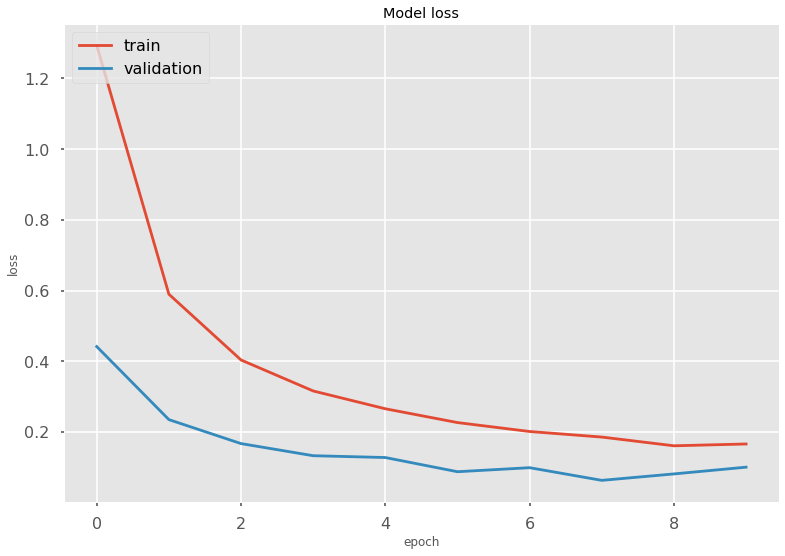

In [563]:
loss_plot(history_9)

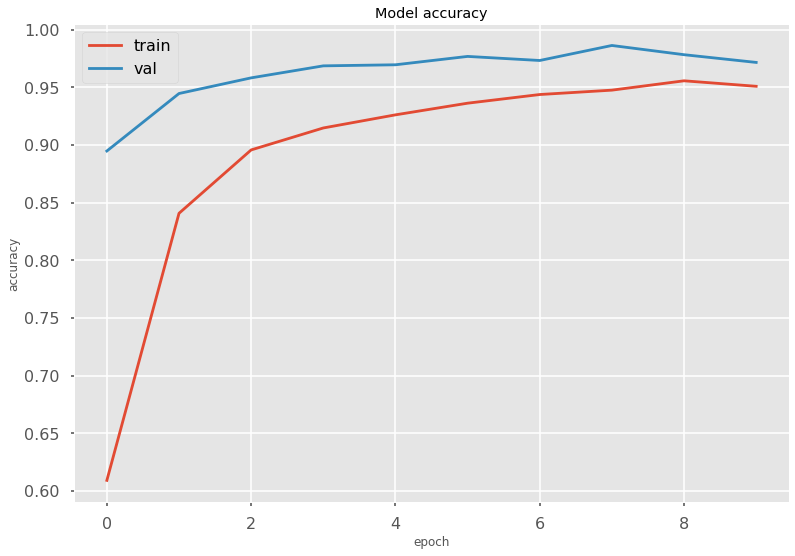

In [564]:
acc_plot(history_9)

[[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 138ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
1/1 [==============================] - 0s 108ms/step
[[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 98ms/step
[[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]]
1/1 [==============================] - 0s 99ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]]
1/1 [==============================] - 0s 86ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]]
1/1 [==============================] - 0s 98ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
1/1 [==============================] - 0s 94ms/step
[[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]]
1/1 [==============================] - 0s 97ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]]
1/1 [==============================] - 0s 100ms/step
[[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
1/1 [==============================] - 0s 106ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]]
1/1 [==============================] - 0s 98ms/step
[[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
1/1 [===========

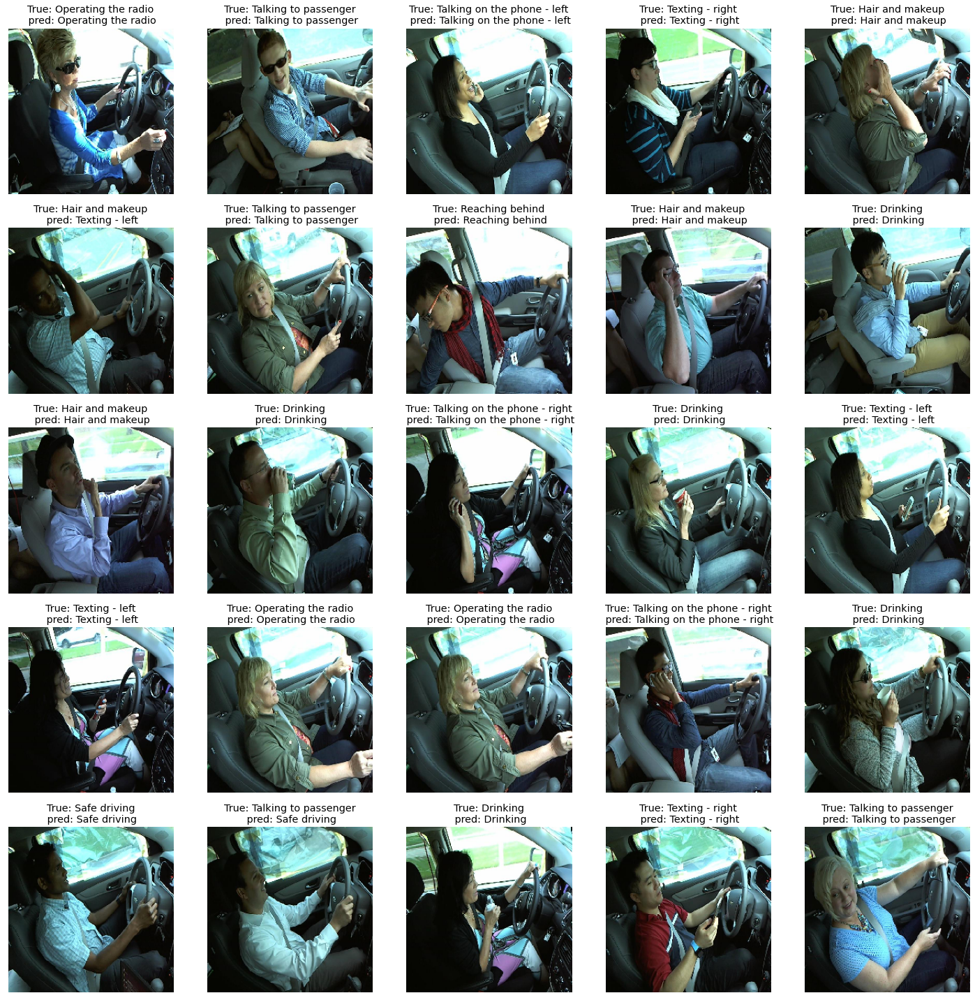

In [749]:
plot_res(vgg16,test_generator_augmentation)

3578/3578 [==============================] - 292s 81ms/step
              precision    recall  f1-score   support

          c0       0.86      0.99      0.92       392
          c1       1.00      0.96      0.98       375
          c2       1.00      0.98      0.99       355
          c3       0.93      0.99      0.96       366
          c4       1.00      0.96      0.98       360
          c5       0.99      0.99      0.99       373
          c6       0.99      0.98      0.98       379
          c7       1.00      0.99      1.00       313
          c8       0.95      0.98      0.96       332
          c9       0.99      0.82      0.90       333

    accuracy                           0.97      3578
   macro avg       0.97      0.97      0.97      3578
weighted avg       0.97      0.97      0.97      3578



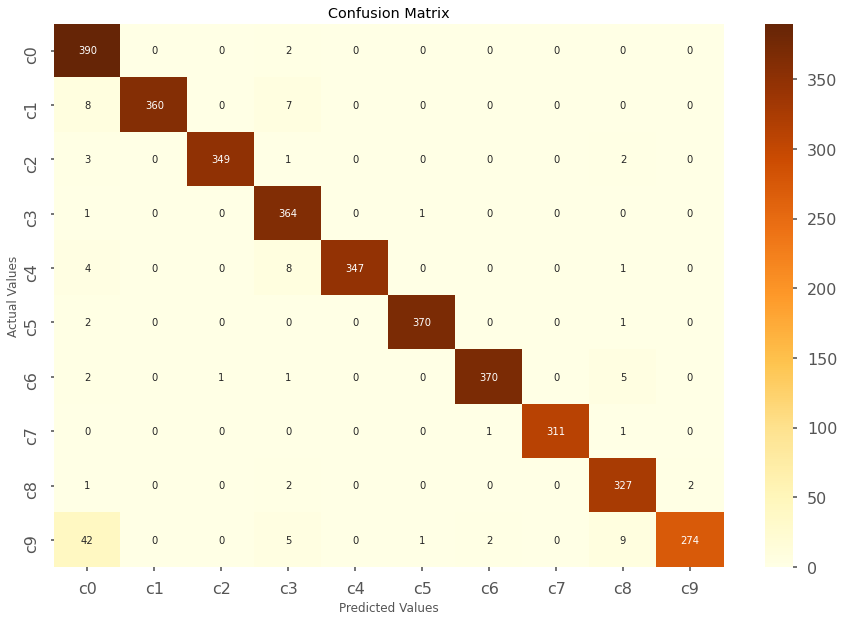

In [830]:
matrix_and_report(vgg16,test_generator_augmentation_cm)

## 4. Result & Findings <a class="anchor" id="chapter4"></a>

After completing the training process, it is now time to compare and select the best model.

In [832]:
normal_models = {"Base Line ":dense_model,"CNN ":cnn_model}

aug_models = {"Base Line Augmentation" : dense_model_2,"CNN Augmentation":cnn_model_2,
              "MobileNet": mobilenet,"VGG16":vgg16}

pretrained_models = {"ResNet":res_model_3,"ResNet Augmentation":res_model_4}

In [840]:
all_normal_models ={"Model":[],"Loss":[],"Accurecy":[],"Evaluate Time":[]}
time_acc(all_normal_models,normal_models,test_generator_normal)

Base Line 
3578/3578 [==============================] - 156s 44ms/step - loss: 0.2854 - accuracy: 0.9053
Time:  156.42344019992743
CNN 
3578/3578 [==============================] - 41s 11ms/step - loss: 0.0783 - accuracy: 0.9843
Time:  41.01160470000468


In [841]:
all_aug_models ={"Model":[],"Loss":[],"Accurecy":[],"Evaluate Time":[]}
time_acc(all_aug_models,aug_models,test_generator_augmentation)

Base Line Augmentation
3578/3578 [==============================] - 157s 44ms/step - loss: 1.6631 - accuracy: 0.3390
Time:  156.9471607999876
CNN Augmentation
3578/3578 [==============================] - 41s 11ms/step - loss: 0.1338 - accuracy: 0.9578
Time:  40.631099199992605
MobileNet
3578/3578 [==============================] - 78s 22ms/step - loss: 0.4204 - accuracy: 0.8681
Time:  78.06042930006515
VGG16
3578/3578 [==============================] - 303s 85ms/step - loss: 0.1137 - accuracy: 0.9676
Time:  303.4818100000266


In [842]:
all_pretrained_models ={"Model":[],"Loss":[],"Accurecy":[],"Evaluate Time":[]}
time_acc(all_pretrained_models,pretrained_models,test_generator_resnet)

ResNet
3578/3578 [==============================] - 282s 79ms/step - loss: 0.2104 - accuracy: 0.9424
Time:  282.49034010001924
ResNet Augmentation
3578/3578 [==============================] - 303s 85ms/step - loss: 0.1540 - accuracy: 0.9570
Time:  303.39106880000327


In [845]:
models_1 = pd.DataFrame.from_dict(all_normal_models)
models_2 = pd.DataFrame.from_dict(all_pretrained_models)
models_3 = pd.DataFrame.from_dict(all_aug_models)

models_comp = pd.concat([models_1, models_2,models_3], ignore_index=True)
models_comp = models_comp.sort_values(by=['Accurecy','Loss'],ascending=False)
models_comp

,Model,Loss,Accurecy,Evaluate Time
1,CNN,0.078323,0.984349,41.011605
7,VGG16,0.113724,0.967580,303.481810
5,CNN Augmentation,0.133827,0.957798,40.631099
3,ResNet Augmentation,0.154026,0.956959,303.391069
2,ResNet,0.210400,0.942426,282.490340
0,Base Line,0.285367,0.905254,156.423440
6,MobileNet,0.420447,0.868083,78.060429
4,Base Line Augmentation,1.663103,0.339016,156.947161


#### According to the Classification report and confution matrix of each Model, I'll Choose ResNet with fine-tuning version.

Let's Run a Quick test

In [376]:
def import_and_predict(image_data, model):
    size = (224, 224)
    resized = cv2.resize(image_data, size)
    img = np.array(resized)
    img_reshape = np.reshape(img,[1, 224, 224, 3])
    prediction = model.predict(img_reshape)
    return prediction

BaseLine
1/1 [==============================] - 2s 2s/step
Talking on the phone - left
Time:  2.227885299944319
****************************************************************************************************
BaseLine Augmentation
1/1 [==============================] - 1s 1s/step
Safe driving
Time:  1.479310900089331
****************************************************************************************************
CNN
1/1 [==============================] - 0s 94ms/step
Talking to passenger
Time:  0.14696280006319284
****************************************************************************************************
CNN Augmentation
1/1 [==============================] - 0s 100ms/step
Reaching behind
Time:  0.15486320003401488
****************************************************************************************************
Mobilenet
1/1 [==============================] - 1s 667ms/step
Reaching behind
Time:  0.7233186999801546
****************************************************

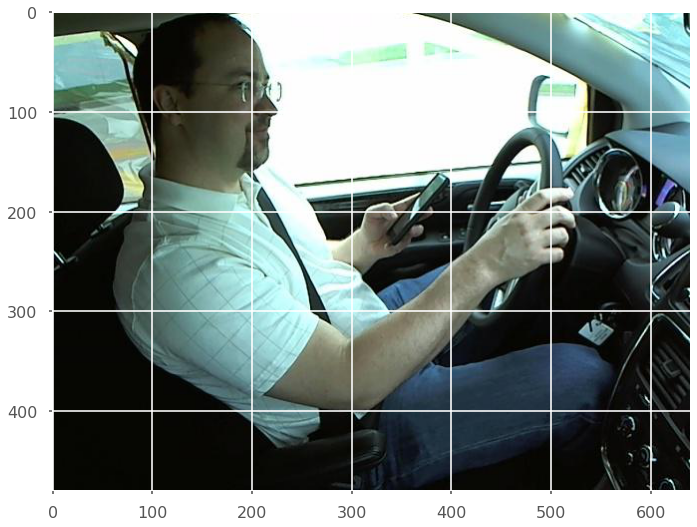

In [897]:
testing_models ={"BaseLine":dense_model,"BaseLine Augmentation":dense_model_2,
                 "CNN":cnn_model,"CNN Augmentation":cnn_model_2,
                 "Mobilenet":mobilenet,"VGG16 Augmentation":vgg16,
                 "Resnet":res_model_3,"Resnet Augmentation":res_model_4}
for name,model in testing_models.items():
    print(name)
    start = timeit.default_timer()
    im = mpimg.imread(r'D:\Uni\EPITA\S4\Computer Vision\Attenton\test\img_70.jpg')
    plt.imshow(im)
    predictions= import_and_predict(im,model)
    pred_label=activity_map.get("c"+str(int(np.argmax(predictions))))

    stop = timeit.default_timer()
    print(pred_label)
    print('Time: ', stop - start)  
    print("*"*100)

In [898]:
tf.keras.models.save_model(res_model_4, 'res_model_4.hdf5')

## 4. Reference <a class="anchor" id="chapter5"></a>

1. Adam vs SGD <br> https://medium.com/geekculture/a-2021-guide-to-improving-cnns-optimizers-adam-vs-sgd-495848ac6008
2. ResNet and VGG 16 <br> https://www.analyticsvidhya.com/blog/2020/08/top-4-pre-trained-models-for-image-classification-with-python-code/